# Wstęp
    Kiedyś uznawane za dobro luksusowe, w dzisiejszych czasach wino staje się coraz popularniejsze wśród coraz większego zakresu konsumentów. Portugalia znajduje się w pierwszej 10 krajów eksportujących wino, z 3% udziałów w rynku w 2017 roku. Eksport wina vinho verde ( z regionu północno-zachodniego) wzrósł o 36% na przestrzeni lat 1997-2007. Aby wspomagać rozwój rynku, przemysł winiarski inwestuje w nowe technologie dla produkcji i sprzedaży wina. W tym kontekście certyfikacja wina oraz ocena jakości zdają się czynnikami kluczowymi. Certyfikacja zapobiega nielegalnemu fałszerstwu wina, ocena jakości natomiast używana jest aby polepszyć proces produkcji poprzez identyfikację elementów kluczowych.

    Certyfikacja wina odbywa się na podstawie właściwości fizykochemicznych oraz analizy sensorycznej. Fizykochemiczne testy laboratoryjne rutynowo używane do charakterystyki  dotyczą oceny gęstości, zawartości alkoholu, czy wartości pH, testy sensoryczne natomiast opierają się na opiniach ekspertów. Jako że smak jest najmniej rozumianym ze zmysłów ludzkich, klasyfikacja jest procesem trudnym. Dodatkowo powiązania między testami fizykochemicznymi a sensorycznymi są skomplikowane i nie do końca rozumiane. 

    Celem niniejszego projektu jest próba klasyfikacji jakości wina na łatwo dostępnych właściwości fizykochemicznych :
    1 - fixed acidity - kwasowość ustalona 
    2 - volatile acidity - kwasowość lotna 
    3 - citric acid - kwas cytrynowy 
    4 - residual sugar - cukier resztkowy 
    5 - chlorides - chlorki
    6 - free sulfur dioxide - wolne dwutleneki siarki
    7 - total sulfur dioxide - całkowita zawartość dwutlenku siarki
    8 - density - gęstość
    9 - pH
    10 - sulphates - siarczany
    11 - alcohol - alkohol

### Dane dotyczące wina:

    Projekt dotyczy vinho verde, unikatowego produktu z Portugalii. Wino to, o średniej zawartości alkoholu cenione jest ze względu na swoje właściwości orzeźwiające. Dane zostały uzyskane poprzez zautomatyzowany system laboratoryjny i zapisane jak baza danych (macierz) w formie pliku (.csv). Każdy obiekt to inne unikatowe wino. Aby uniknąć zbędnego odrzucania obiektów, wartości cech zostały wybrane z najczęstszych wyników testów fizykochemicznych. Jako że wino czerwone i białe smakują inaczej, ich analizy będą odbywać się oddzielnie, stąd dwie macierze danych: 1599 obiektów dla wina czerwonego i 4898 dla wina białego. Jeśli chodzi o atrybut decyzyjny - jakość - została ona dobrana na podstawie minimum 3 testów sensorycznych dla każdego obiektu, w którym wina były oceniane od 0 (bardzo złe) do 10 (wyśmienite). Jakość końcowa to mediana wyników tych testów.

### Podejście do klasyfikacji:

    W procesie klasyfikacji użyte zostaną następujące metody: 

    - Metoda k-najbliższych sąsiadów
    - Metoda najbliższego prototypu
    - Drzewa decyzyjne

    Wyniki klasyfikacji dla każdej z metod zostaną ocenione za pomocą macierz pomyłek. Dzięki temu można wyznaczyć która metoda sprawdzi się najlepiej dla zaprezentowanego zbioru danych. Aby zapewnić poprawność modelu, ze zbioru wyodrębnione zostaną losowo dwa podzbiory ( takie same dla każdej z metod). Pierwszy - zbiór testowy (⅓ danych) - nie bierze udziału w procesie uczenia, a jedynie pozwala na kontrolę opracowanego modelu i ocenę jego skuteczności. Drugi - zbiór uczący (⅔ danych) - służy do opracowania modelu. Zbiór zostanie poddany generalizacji - tak aby jak najbardziej przybliżyć do siebie wartości liczbowe aby żadna cecha nie miała zbyt znaczącego wpływu na wynik klasyfikacji. Podczas analizy eksploracyjnej należy wyodrębnić ze zbioru cechy które mają zbyt dużą korelację - innymi słowy cechy które będą miały nieznaczny wpływ na klasyfikację.


Wczytanie niezbędnych pakietów

In [4]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

# zmiana sposobu wyświetlania danych typu float
pd.options.display.float_format = "{:.2f}".format 
from sklearn.model_selection import train_test_split
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import NearestCentroid
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LinearRegression
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn import tree
from sklearn import preprocessing
from sklearn import metrics
from sklearn.datasets import make_classification


Funkcja dzieląca macierz danch na zbiór uczący i testowy

In [5]:
def podziel(df,proporcja):
    # df - ramka danych; proporcja - proporcja podzialu (0-1)
    # zwraca słownik z kluczami:
    # opis_ucz/opis_test - macierz atrybutów opisujących zbioru uczącego/testowego
    # dec_ucz/dec_test - wektor wartosci atrybutu decyzyjnego zbioru uczącego/testowego
    opis_ucz, opis_test, dec_ucz, dec_test = train_test_split(df.iloc[:,0:-1], df.iloc[:,-1].astype('category').cat.codes, test_size=proporcja, random_state=1)
    return {"opis_ucz":opis_ucz, "opis_test":opis_test, "dec_ucz":dec_ucz, "dec_test":dec_test}


Funkcja wyświetlająca granice decyzyjne

In [31]:
def granice(model,dane,atr_x, atr_y,tytul,kontur = 1):
    # model - model klasyfikatora
    # dane - dane (słownik zwracany przez funkcje podziel)
    # atr_x/atr_y - artybut wyswietlany na osi x/y
    # tytul - wyświetlany tytuł wykresu
    # kontur - par. opcjonalny (=0 -> brak konturu)
    if (kontur == 1):    
        model.fit(dane["opis_ucz"].iloc[:,[atr_x,atr_y]], dane["dec_ucz"])
        x_min = min(dane["opis_ucz"].iloc[:, atr_x].min(),dane["opis_test"].iloc[:, atr_x].min())
        x_max = max(dane["opis_ucz"].iloc[:, atr_x].max(),dane["opis_test"].iloc[:, atr_x].max())
        y_min = min(dane["opis_ucz"].iloc[:, atr_y].min(),dane["opis_test"].iloc[:, atr_y].min())
        y_max = max(dane["opis_ucz"].iloc[:, atr_y].max(),dane["opis_test"].iloc[:, atr_y].max())
        rozst_x = x_max - x_min
        rozst_y = y_max - y_min
        x_min = x_min - 0.1*rozst_x
        x_max = x_max + 0.1*rozst_x
        y_min = y_min - 0.1*rozst_y
        y_max = y_max + 0.1*rozst_y       
        xx, yy = np.meshgrid(np.arange(x_min, x_max, (x_max-x_min)/150),
                     np.arange(y_min, y_max, (y_max-y_min)/150))
        Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
        Z = Z.reshape(xx.shape)
    plt.figure(dpi = 100)
    plt.title(tytul)
    if (kontur == 1):
        plt.contourf(xx, yy, Z, levels = 4, alpha=0.2)
    plt.scatter(dane["opis_ucz"].iloc[:, atr_x], dane["opis_ucz"].iloc[:, atr_y], c=dane["dec_ucz"], marker = '.')
    plt.scatter(dane["opis_test"].iloc[:, atr_x], dane["opis_test"].iloc[:, atr_y], c=dane["dec_test"], marker = 'x')

Wyświetla wynik weryfikacji klasyfikatora w postaci macierzy pomyłek dla zbioru uczącego i testowego, zwraca macierz dla zbioru testowego

In [6]:

def weryfikuj(model, daneXx, atryb):
    # wyswietla wynik weryfikacji klasyfikatora w postaci macierzy pomyłek
    # dla zbioru uczącego i testowego
    # model - model klasyfikatora
    # dane - dane (słownik zwracany przez funkcje podziel)
    # atryb - lista atrybutów uwzględnianych w weryfikacji
    d = daneXx
    model.fit(daneXx["opis_ucz"].iloc[:, atryb], daneXx["dec_ucz"])
    wynik_ucz = model.predict(daneXx["opis_ucz"].iloc[:, atryb])
    wynik_test = model.predict(daneXx["opis_test"].iloc[:, atryb])
    mp = confusion_matrix(daneXx["dec_ucz"], wynik_ucz)
    print("macierz pomyłek - zbiór uczący, dokładność:",np.sum(np.diag(mp))/np.sum(mp))
    print(model.score(d['opis_ucz'],d['dec_ucz']))
    print(mp)
    mp = confusion_matrix(daneXx["dec_test"], wynik_test)
    print("macierz pomyłek - zbiór testowy, dokładność:",np.sum(np.diag(mp))/np.sum(mp))
    print(model.score(d['opis_test'],d['dec_test']))
    print(mp)
    return mp

## Wina czerwone - Ekspoloracja danych

In [93]:
from azureml.core import Workspace, Dataset, Experiment

subscription_id = '1f605b90-26fe-4ce1-8e83-98b82a341dec'
resource_group = 'Azure_for_Students_starter'
workspace_name = 'PRiAD_Workspace'

workspace = Workspace(subscription_id, resource_group, workspace_name)
experiment = Experiment(workspace, 'Wine_quality_modeling')

dataset = Dataset.get_by_name(workspace, name='red_wine_dataset')
dataset=dataset.to_pandas_dataframe()


dane0 = dataset
dane0.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.40,0.70,0.00,1.90,0.08,11.00,34.00,1.00,3.51,0.56,9.40,5
1,7.80,0.88,0.00,2.60,0.10,25.00,67.00,1.00,3.20,0.68,9.80,5
2,7.80,0.76,0.04,2.30,0.09,15.00,54.00,1.00,3.26,0.65,9.80,5
3,11.20,0.28,0.56,1.90,0.07,17.00,60.00,1.00,3.16,0.58,9.80,6
4,7.40,0.70,0.00,1.90,0.08,11.00,34.00,1.00,3.51,0.56,9.40,5


In [10]:
dane0.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.00,1599.00,1599.00,1599.00,1599.00,1595.00,1597.00,1599.00,1599.00,1599.00,1599.00,1599.00
mean,8.32,0.53,0.27,2.54,0.09,15.84,46.43,1.00,3.31,0.66,10.42,5.64
std,1.74,0.18,0.19,1.41,0.05,10.42,32.90,0.00,0.15,0.17,1.07,0.81
min,4.60,0.12,0.00,0.90,0.01,1.00,6.00,0.99,2.74,0.33,8.40,3.00
25%,7.10,0.39,0.09,1.90,0.07,7.00,22.00,1.00,3.21,0.55,9.50,5.00
50%,7.90,0.52,0.26,2.20,0.08,14.00,38.00,1.00,3.31,0.62,10.20,6.00
75%,9.20,0.64,0.42,2.60,0.09,21.00,62.00,1.00,3.40,0.73,11.10,6.00
max,15.90,1.58,1.00,15.50,0.61,72.00,289.00,1.00,4.01,2.00,14.90,8.00


In [11]:

# liczba obiektów
ile_obiektow = len(dane0.index)
print("obiektów:", ile_obiektow)

# liczba klas
print("liczba klas: ", len(dane0.groupby("quality").size().index))

# liczba obiektów w każdej klasie
print("liczba obiektow w klasach:")
print(dane0.groupby("quality").size())

# liczba atrybutów
print("liczba atrybutów: ", len(dane0.columns))

# liczba danych brakujących
print("liczba wierszy z danymi brakujacymi: ", sum(dane0.apply(lambda x: sum(x.isnull().values), axis = 1)>0))
print("liczba danych brakujacych: ", dane0.isnull().sum().sum())

obiektów: 1599
liczba klas:  6
liczba obiektow w klasach:
quality
3     10
4     53
5    681
6    638
7    199
8     18
dtype: int64
liczba atrybutów:  12
liczba wierszy z danymi brakujacymi:  6
liczba danych brakujacych:  6


### Badanie rokładu i zmienności atrybutów - tutaj zastosowlaiśmy odchylenie standardowe i wykresy skrzypcowe dla różnych kombinacji atrybut-klasa, klasa-atrybuty, aby zwizualizować skrajne wartości i jak w poszcególnych klasach rozkładają się wartości atrybutów

fixed acidity           1.74
volatile acidity        0.18
citric acid             0.19
residual sugar          1.41
chlorides               0.05
free sulfur dioxide    10.42
total sulfur dioxide   32.90
density                 0.00
pH                      0.15
sulphates               0.17
alcohol                 1.07
dtype: float64


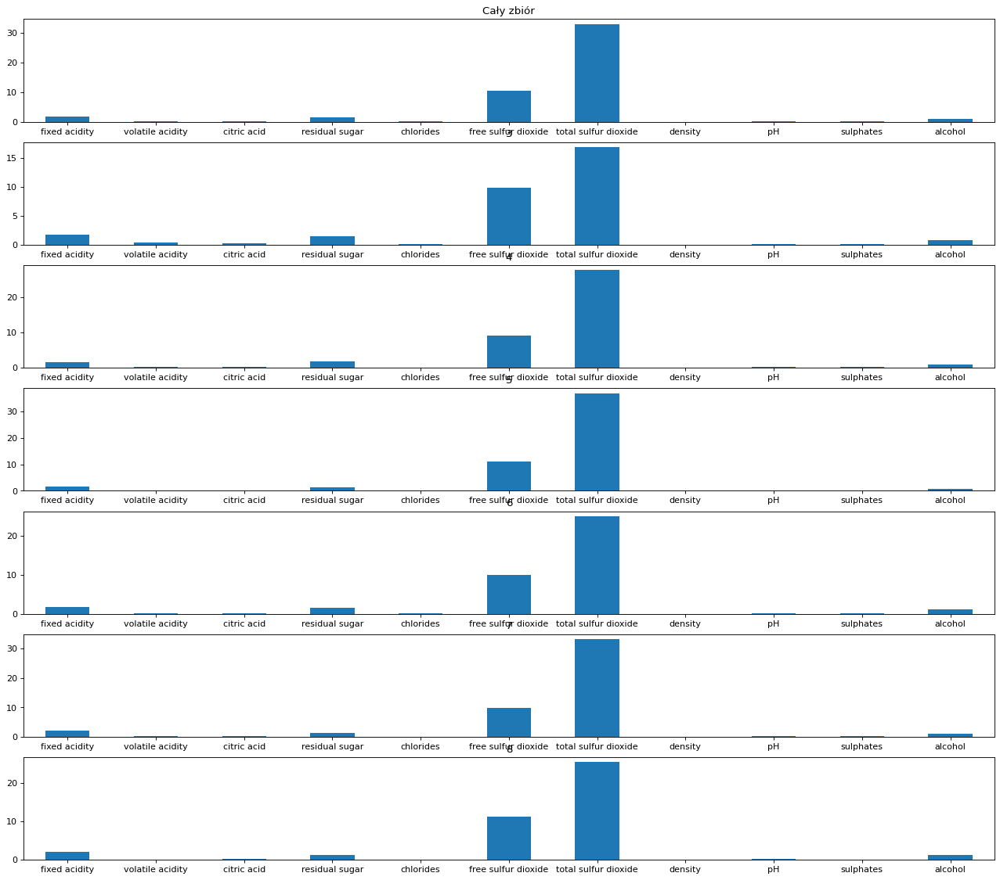

In [12]:
roz_dane = dane0.drop(columns='quality')
print(roz_dane.std())

plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(8, 1, 1)
ax = roz_dane.std().plot.bar(rot=0)
plt.title("Cały zbiór")


classes = dane0.quality.drop_duplicates().sort_values()
for i in classes:
    cla = dane0[dane0.quality == i].drop(columns='quality')
    plt.subplot(8, 1, i-1)
    ax = cla.std().plot.bar(rot=0)
    ax.title.set_text(i)

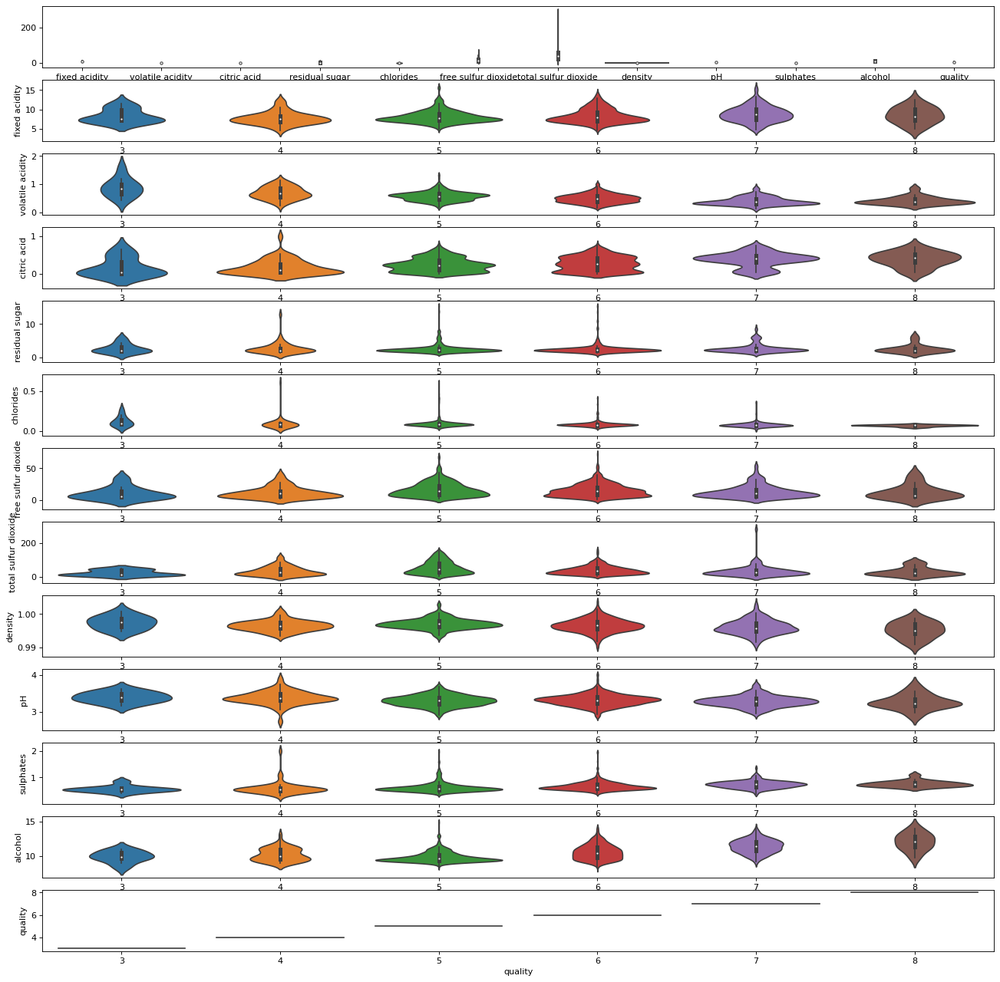

In [13]:
plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(13,1,1)
sns.violinplot(data=dane0)
j = 2
for i in dane0.columns:
    plt.subplot(13,1,j)
    sns.violinplot(x="quality", y = i, data=dane0)
    j+=1

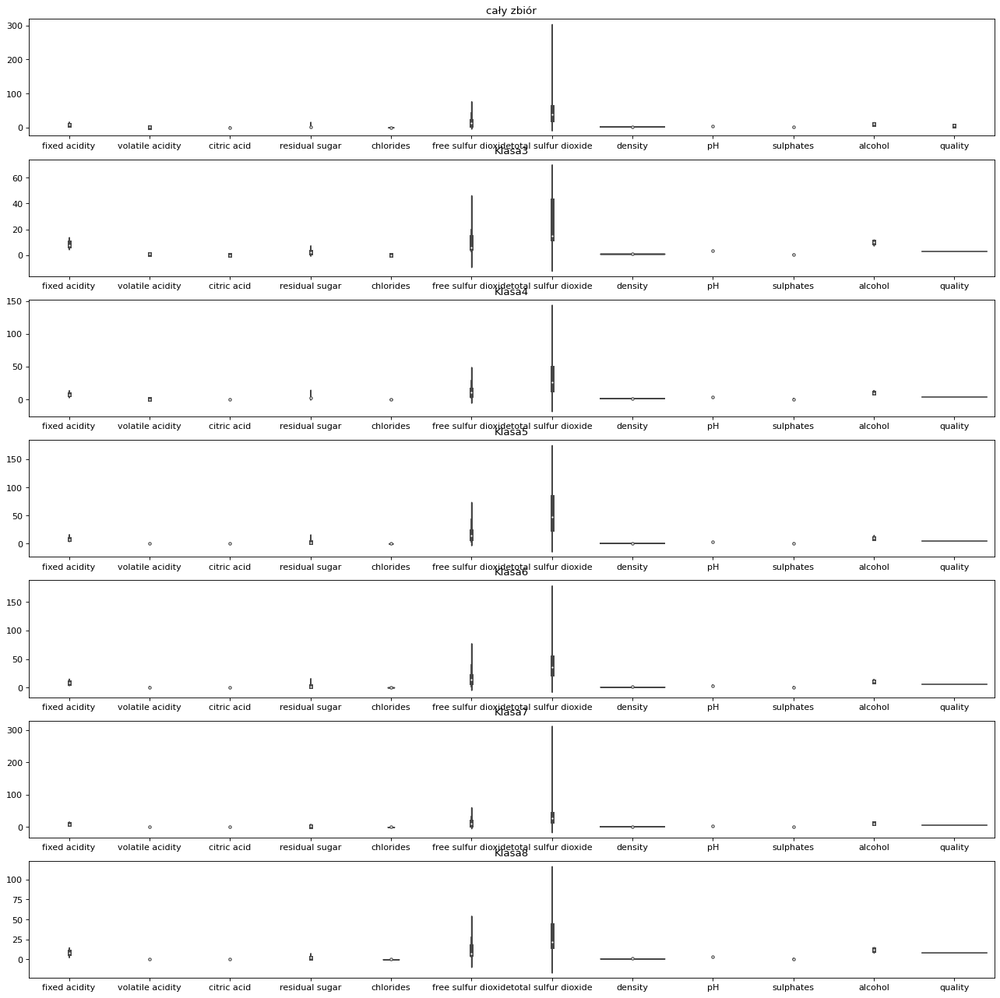

In [14]:
plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(7,1,1)
sns.violinplot(data=dane0)
plt.title("cały zbiór")
j = 2

classes = dane0.quality.drop_duplicates().sort_values()
for i in classes:
    plt.subplot(7,1,j)
    sns.violinplot(data=dane0.loc[dane0.quality==i])
    plt.title("Klasa"+str(i))

    j+=1

### Badanie zależności i wspołwystępowania klas - tutaj zastosowaliśmy macierz wykresów punktowych i macierz korelacji, pozwoliło to na ocenę przydatności poszcególnych atrybutów w rozróżnianiu klas i ewentulną eliminację silnie skorelowanych aktrybutów lub zbędnych.

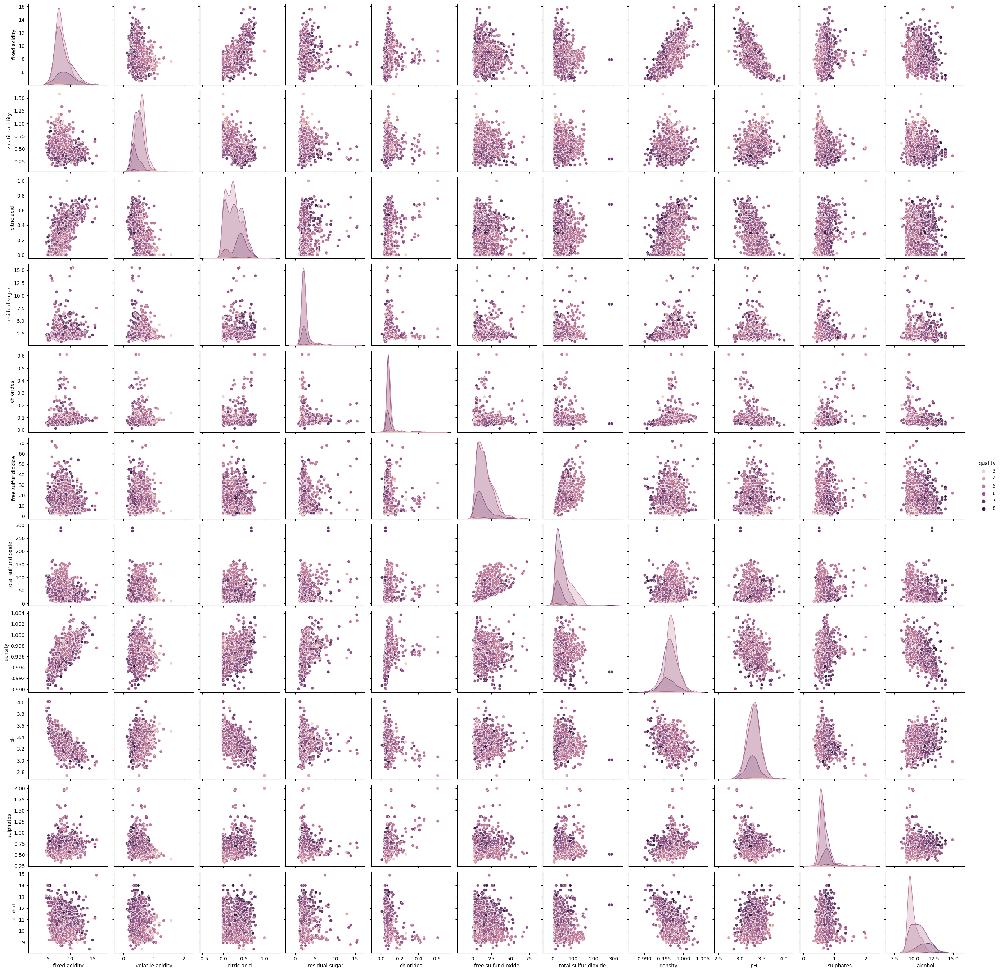

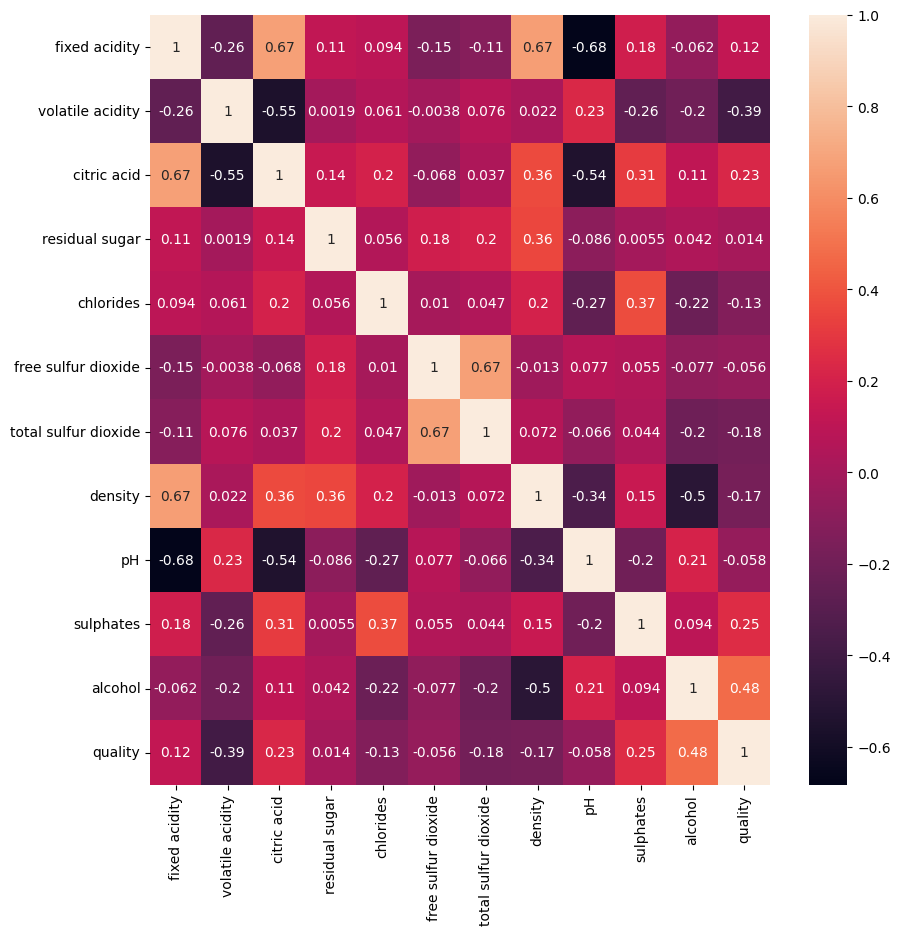

In [15]:
sns.pairplot(dane0, kind="scatter", hue='quality')
plt.show()


plt.figure(figsize=(10,10),dpi = 100)
sns.heatmap(dane0.corr(),annot = dane0.corr())
plt.show()

Wstępne wnioski i obserwacje
* Analizując rozkład atrybutów dochodzimy do wniosku, że zachodzi potrzeba zmiany rozkładu atrybutów ze względu na znaczącą róznicę w zmienności i wartościach min,max atrybutu "total sulfur dioxide" oraz "free sulfur dioxide" w stosunku do pozostałych atrybutów.

* Kolejny wniosek, który się nasuwa to, że różnice pomiędzy poszczególnywmi jakościami wina są bardzo subtelne, co pokazują wykresy skrzypcowe poszczególnych atrybutów dla klas i macierz wykresów punktowych.

* Bez standaryzacji nie widać atrybutów, które mogłyby być zbędne lub które jasno wskazują na poszczególne klasy. Każdy z wykresów punktowych pokazuje jednak pewien gradient przechodzacy od win gorszej jakosci do tych o lepszej jakości, szczególnie jest to widoczne na wykresie alkohol-ph, gdzie widać koncentracje punktów symbolizujących lepszej jakości wina w jednym z krańców a win gorszych na drugim z krańców.

* Rozkład atrybutów w każdym przypadku skupia się w dużej części wokół mediany.

* Rozkład histogramów "residual sugar"  i "chlorides" sugerują, że te atrybuty mogą być zbędne. Histogramy nie prezentują żadnego podziału na klasy, maxima znajudją się w tym samym miejscu, a wykresu punktowe z tymi atrybutami nie przedstawiają "gradientu" podziału klasy jakości.

### Standaryzacja i weryfikacja wyniku

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count        1599.00           1599.00      1599.00         1599.00   
mean            0.00              0.00         0.00           -0.00   
std             1.00              1.00         1.00            1.00   
min            -2.14             -2.28        -1.39           -1.16   
25%            -0.70             -0.77        -0.93           -0.45   
50%            -0.24             -0.04        -0.06           -0.24   
75%             0.51              0.63         0.77            0.04   
max             4.36              5.88         3.74            9.20   

       chlorides  free sulfur dioxide  total sulfur dioxide  density      pH  \
count    1599.00              1595.00               1597.00  1599.00 1599.00   
mean        0.00                -0.00                  0.00    -0.00    0.00   
std         1.00                 1.00                  1.00     1.00    1.00   
min        -1.60                -1.42   

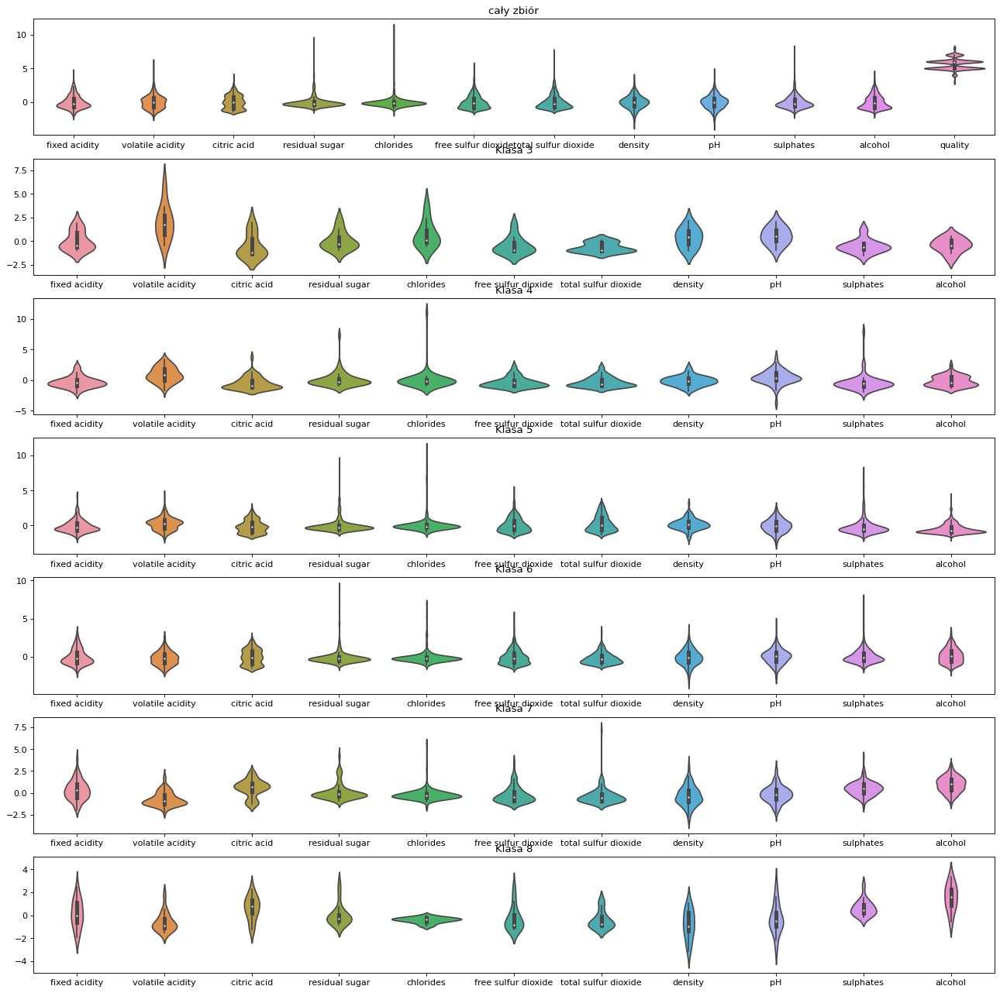

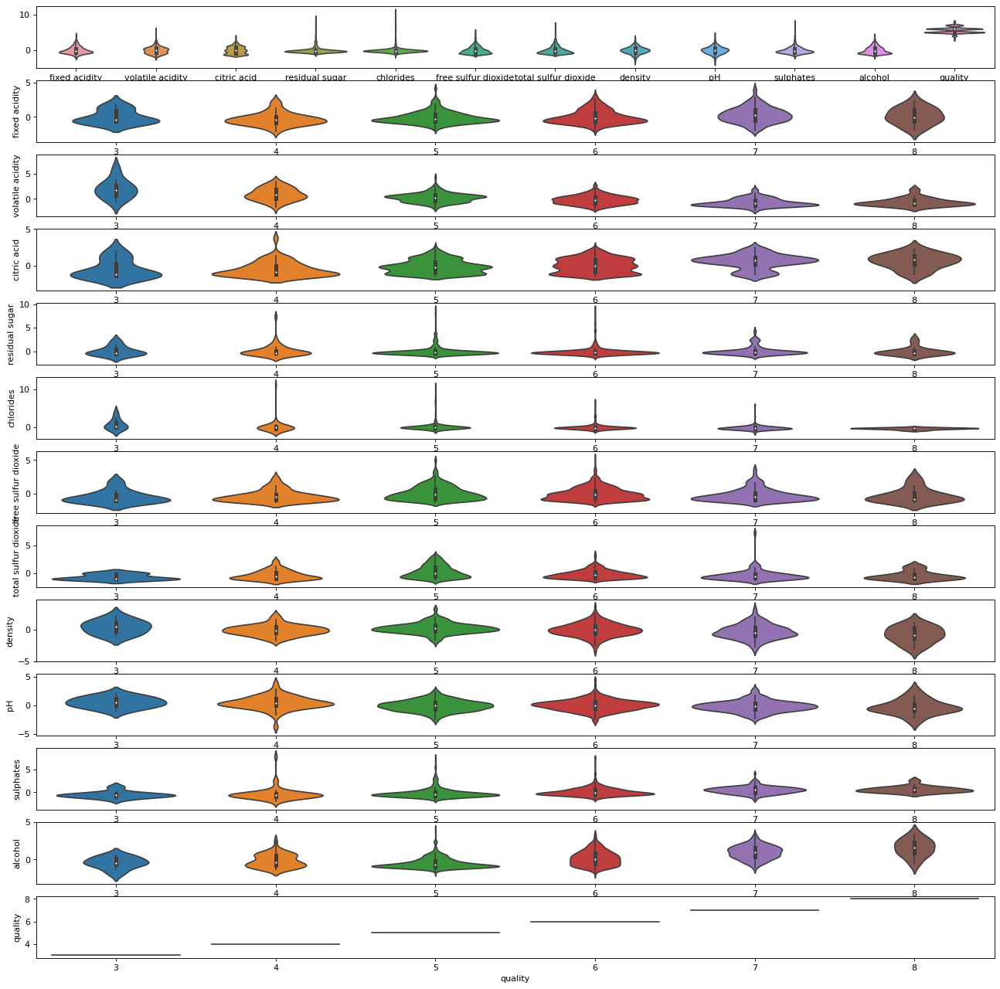

In [16]:
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()

#standaryzacja
X = dane0.drop(columns='quality')
dane_v1 = pd.DataFrame(scale.fit_transform(X), columns=X.columns)
dane_v1['quality']=dane0.quality

# dane_v1 = pd.DataFrame(preprocessing.normalize(X), columns=X.columns)
# dane_v1['quality']=dane0.quality
#-------------------------

print(dane_v1.describe())

plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(7,1,1)
sns.violinplot(data=dane_v1)
plt.title("cały zbiór")


classes = dane_v1.quality.drop_duplicates().sort_values()
for j,i in enumerate(classes):
    plt.subplot(7,1,j+2)
    plt.title("Klasa "+str(i))
    sns.violinplot(data=dane_v1.loc[dane_v1.quality==i].drop(columns='quality'))


plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(13,1,1)
sns.violinplot(data=dane_v1)
j = 2
for i in dane_v1.columns:
    plt.subplot(13,1,j)
    sns.violinplot(x="quality", y = i, data=dane_v1)
    j+=1

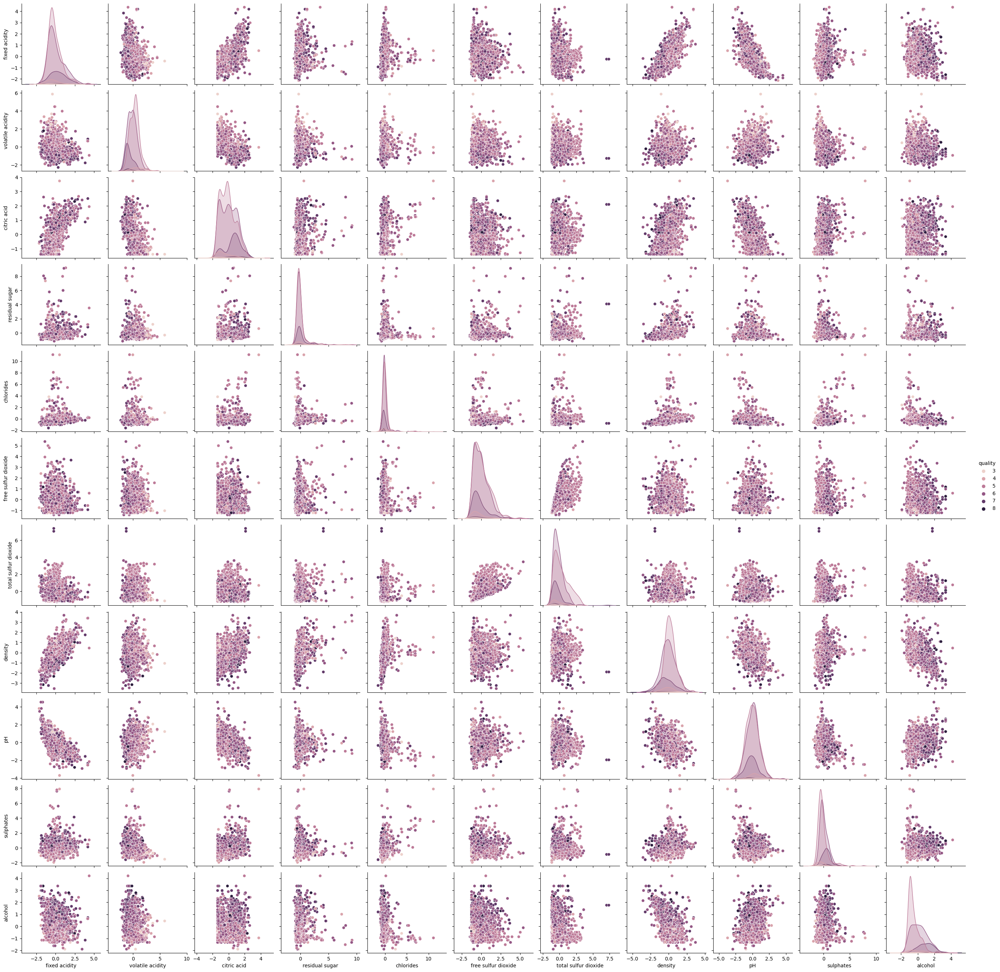

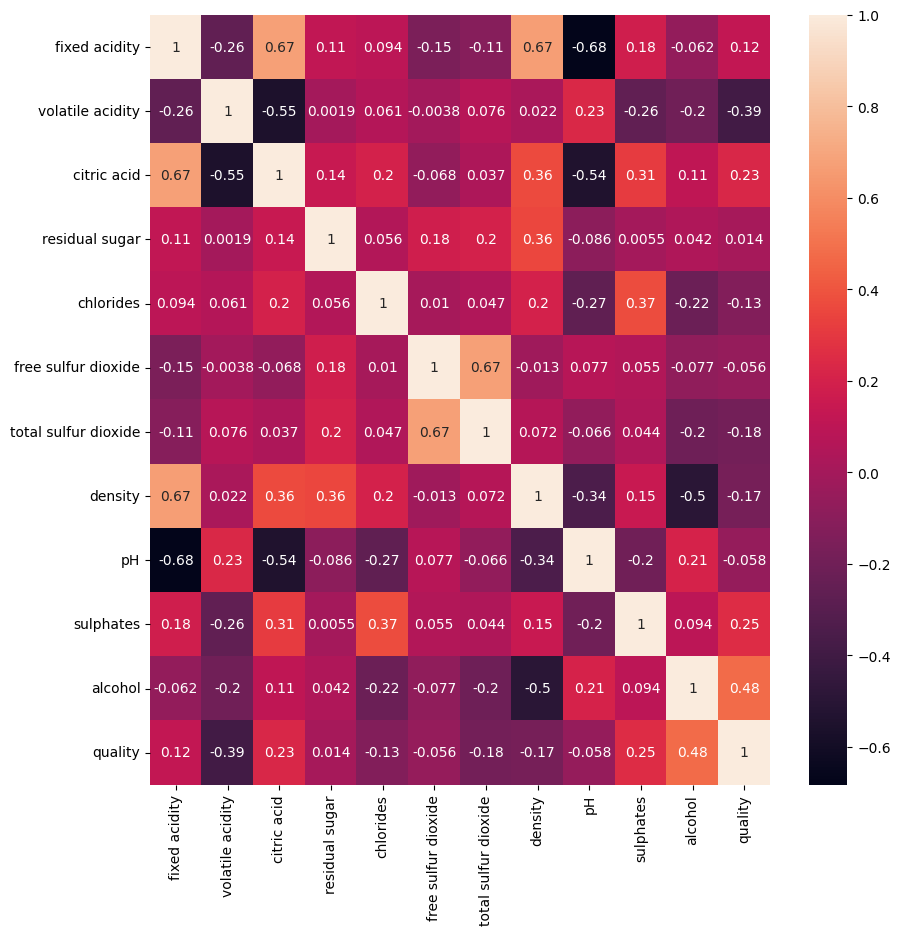

In [17]:
sns.pairplot(dane_v1, kind="scatter", hue='quality')
plt.show()

plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(dane_v1.corr(), annot=dane_v1.corr())
plt.show()

In [18]:
dane_v0_cz = dane0
dane_v1_cz = dane_v1
dane_v1_cz = dane_v1_cz.dropna()

## Wina czerwone - podsumownaie analalizy eksploracyjnej
1. Podstawowe informacje o zbiorze:
    Zbiór zawiera chemiczne właściwości 1599 czerwonych win (atrybuty liczbowe opisowe) i przyporządkowaną do nich jakość wina (atrybut liczbowy decyzyjny)

        obiektów: 1599
        liczba klas:  6
        liczba obiektow w klasach:
        quality
        3     10
        4     53
        5    681
        6    638
        7    199
        8     18
        dtype: int64
        liczba atrybutów:  12
        liczba wierszy z danymi brakujacymi:  0
        liczba danych brakujacych:  0
2. Wnisoki:
* Procent alkholu wydaję się być silnym indykatorem jakości alkoholu, jednak są to delikatne róznice i rozkłady wartości zachaczają o inne klasy, jest to jednak sugestia do stosowania alkoholu z wyższą wagą podczas procesów klasyfikacji.

* Wina czerwone przyjmują tylko wartości jakości od 3 do 8

* Analizując rozkład atrybutów dochodzimy do wniosku, że zachodzi potrzeba zmiany rozkładu atrybutów ze względu na znaczącą róznicę w zmienności i wartościach min,max atrybutu "total sulfur dioxide" oraz "free sulfur dioxide" w stosunku do pozostałych atrybutów. Wybór padał na standaryzację ze względu na stosunkową dużą ilość wartości skrajnych odpowiadającym winą o wyższej lub niższej jakości

* Różnice pomiędzy poszczególnywmi jakościami wina są bardzo subtelne, stąd wszystkie atrybuty prezentują wartość w przypadku klasyfikacji. Nie można jasno stwierdzić które cechy są mniej przydatne, gdyż każde prezentują pewną wartość.

* Nie zachodzi potrzeba usuwania wartości skrajnych, ze względu na ilość skarajnych przypadków w jakości wina, mogłoby to spowodować, że te wartości byłby jeszcze bardziej reprezentowane niż teraz

* Najwięcej win przyjmuje jakość w zakresie 5-7, potencjalne klalsyfikatory mogły by dobrze rozpoznawać te jakośc, co do pozostałych liczebność zbiory i charakter danych w postaci subtelnych różnic pomiędzy klasami, może być przeszkodą w poprawnej klasyfikacji.

3. Wyniki
* dane_v0_cz - zbiór przed standaryzacją
* dane_v1_cz - zbiór po standaryzacji


## Wina białe - Ekspoloracja danych

In [94]:
from azureml.core import Workspace, Dataset, Experiment

subscription_id = '1f605b90-26fe-4ce1-8e83-98b82a341dec'
resource_group = 'Azure_for_Students_starter'
workspace_name = 'PRiAD_Workspace'

workspace = Workspace(subscription_id, resource_group, workspace_name)
experiment = Experiment(workspace, 'Wine_quality_modeling')

dataset = Dataset.get_by_name(workspace, name='white_wine_dataset')
dataset = dataset.to_pandas_dataframe()

dane0 = dataset
dane0.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.00,0.27,0.36,20.70,0.04,45.00,170.00,1.00,3.00,0.45,8.80,6
1,6.30,0.30,0.34,1.60,0.05,14.00,132.00,0.99,3.30,0.49,9.50,6
2,8.10,0.28,0.40,6.90,0.05,30.00,97.00,1.00,3.26,0.44,10.10,6
3,7.20,0.23,0.32,8.50,0.06,47.00,186.00,1.00,3.19,0.40,9.90,6
4,7.20,0.23,0.32,8.50,0.06,47.00,186.00,1.00,3.19,0.40,9.90,6


In [20]:
dane0.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00,4898.00
mean,6.85,0.28,0.33,6.39,0.05,35.31,138.36,0.99,3.19,0.49,10.51,5.88
std,0.84,0.10,0.12,5.07,0.02,17.01,42.50,0.00,0.15,0.11,1.23,0.89
min,3.80,0.08,0.00,0.60,0.01,2.00,9.00,0.99,2.72,0.22,8.00,3.00
25%,6.30,0.21,0.27,1.70,0.04,23.00,108.00,0.99,3.09,0.41,9.50,5.00
50%,6.80,0.26,0.32,5.20,0.04,34.00,134.00,0.99,3.18,0.47,10.40,6.00
75%,7.30,0.32,0.39,9.90,0.05,46.00,167.00,1.00,3.28,0.55,11.40,6.00
max,14.20,1.10,1.66,65.80,0.35,289.00,440.00,1.04,3.82,1.08,14.20,9.00


In [21]:
# liczba obiektów
ile_obiektow = len(dane0.index)
print("obiektów:", ile_obiektow)

# liczba klas
print("liczba klas: ", len(dane0.groupby("quality").size().index))

# liczba obiektów w każdej klasie
print("liczba obiektow w klasach:")
print(dane0.groupby("quality").size())

# liczba atrybutów
print("liczba atrybutów: ", len(dane0.columns))

# liczba danych brakujących
print("liczba wierszy z danymi brakujacymi: ", sum(dane0.apply(lambda x: sum(x.isnull().values), axis = 1)>0))
print("liczba danych brakujacych: ", dane0.isnull().sum().sum())

obiektów: 4898
liczba klas:  7
liczba obiektow w klasach:
quality
3      20
4     163
5    1457
6    2198
7     880
8     175
9       5
dtype: int64
liczba atrybutów:  12
liczba wierszy z danymi brakujacymi:  0
liczba danych brakujacych:  0


### Badanie rokładu i zmienności atrybutów - tutaj zastosowlaiśmy odchylenie standardowe i wykresy skrzypcowe dla różnych kombinacji atrybut-klasa, klasa-atrybuty, aby zwizualizować skrajne wartości i jak w poszcególnych klasach rozkładają się wartości atrybutów

fixed acidity           0.84
volatile acidity        0.10
citric acid             0.12
residual sugar          5.07
chlorides               0.02
free sulfur dioxide    17.01
total sulfur dioxide   42.50
density                 0.00
pH                      0.15
sulphates               0.11
alcohol                 1.23
dtype: float64


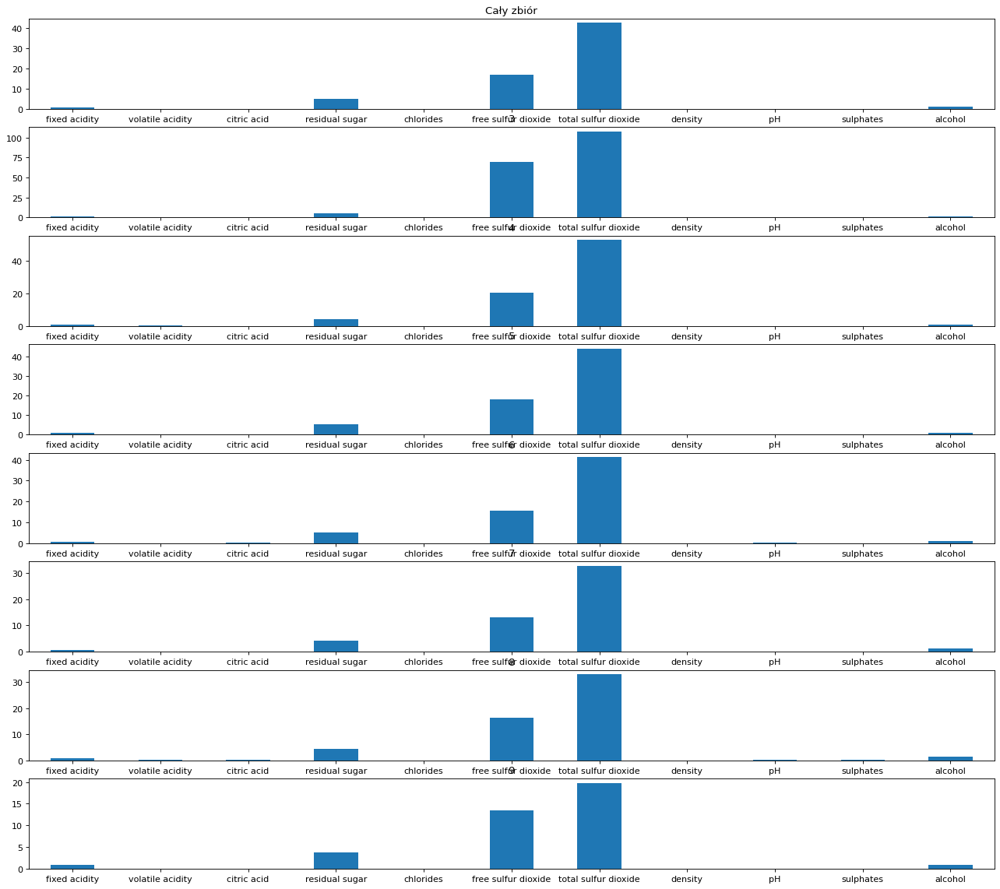

In [22]:
roz_dane = dane0.drop(columns='quality')
print(roz_dane.std())

plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(9, 1, 1)
ax = roz_dane.std().plot.bar(rot=0)
plt.title("Cały zbiór")


classes = dane0.quality.drop_duplicates().sort_values()
for i in classes:
    cla = dane0[dane0.quality == i].drop(columns='quality')
    plt.subplot(9, 1, i-1)
    ax = cla.std().plot.bar(rot=0)
    ax.title.set_text(i)

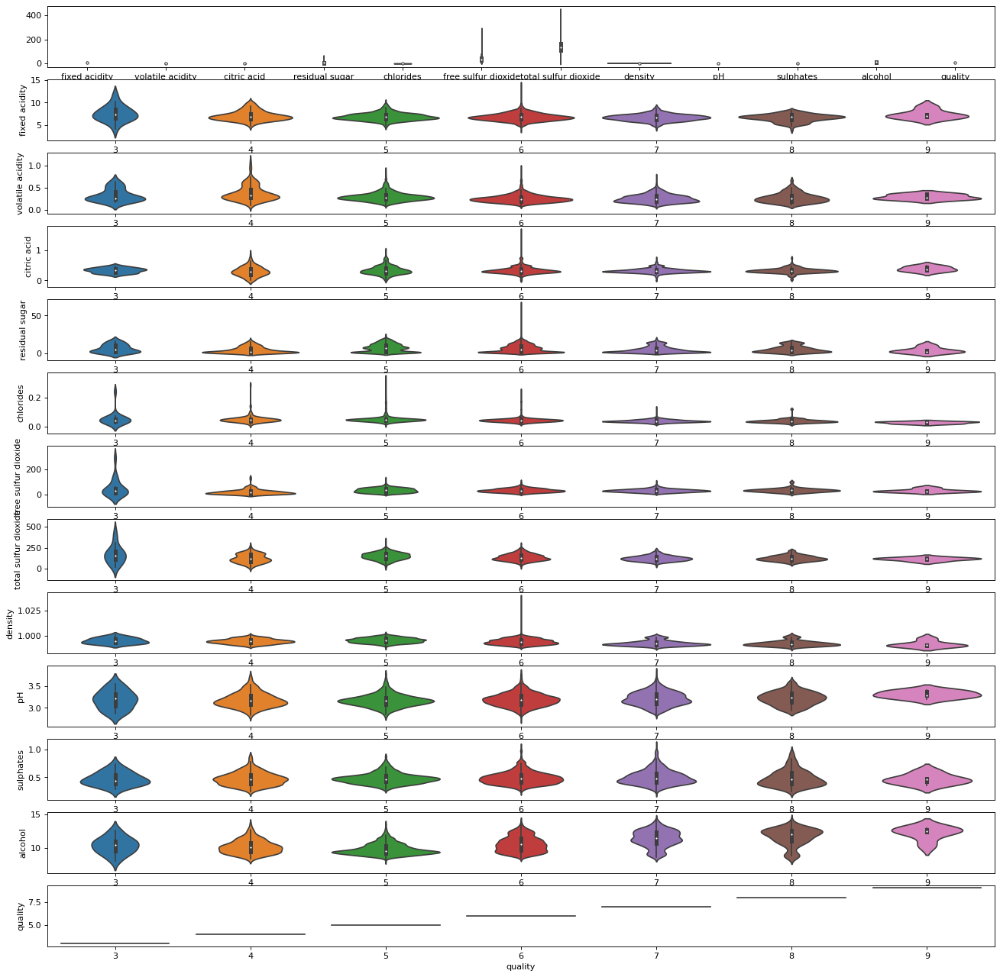

In [23]:
plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(13,1,1)
sns.violinplot(data=dane0)
j = 2
for i in dane0.columns:
    plt.subplot(13,1,j)
    sns.violinplot(x="quality", y = i, data=dane0)
    j+=1

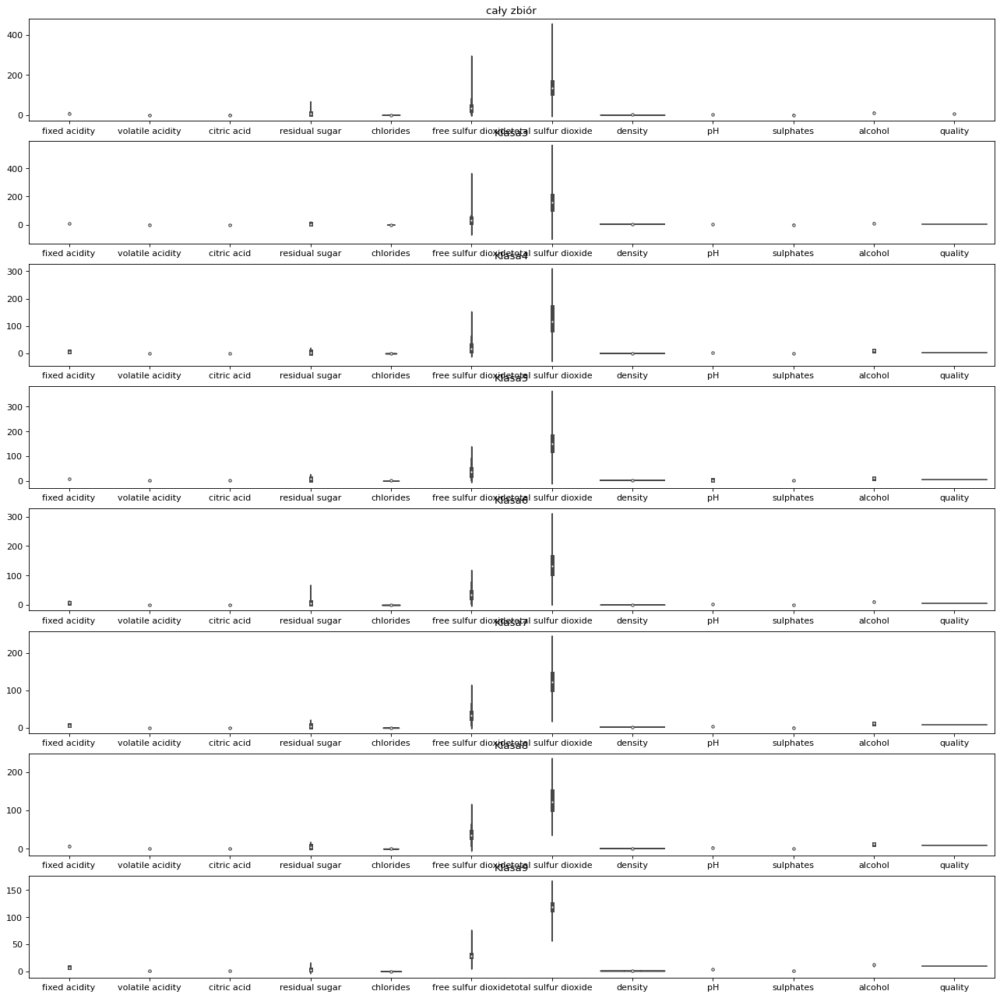

In [24]:
plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(8,1,1)
sns.violinplot(data=dane0)
plt.title("cały zbiór")
j = 2

classes = dane0.quality.drop_duplicates().sort_values()
for i in classes:
    plt.subplot(8,1,j)
    sns.violinplot(data=dane0.loc[dane0.quality==i])
    plt.title("Klasa"+str(i))

    j+=1

### Badanie zależności i wspołwystępowania klas - tutaj zastosowaliśmy macierz wykresów punktowych i macierz korelacji, pozwoliło to na ocenę przydatności poszcególnych atrybutów w rozróżnianiu klas i ewentulną eleiminacje silnie skorelowanych aktrybutów lub zbędnych.

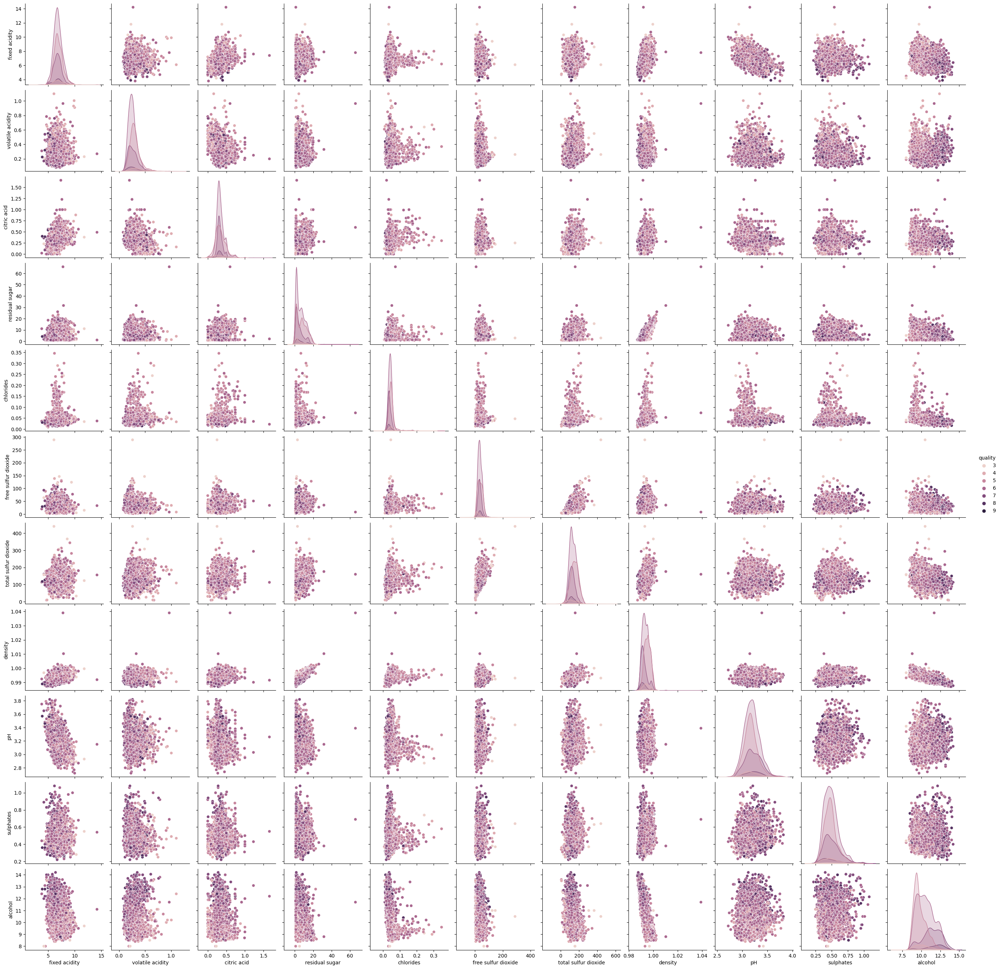

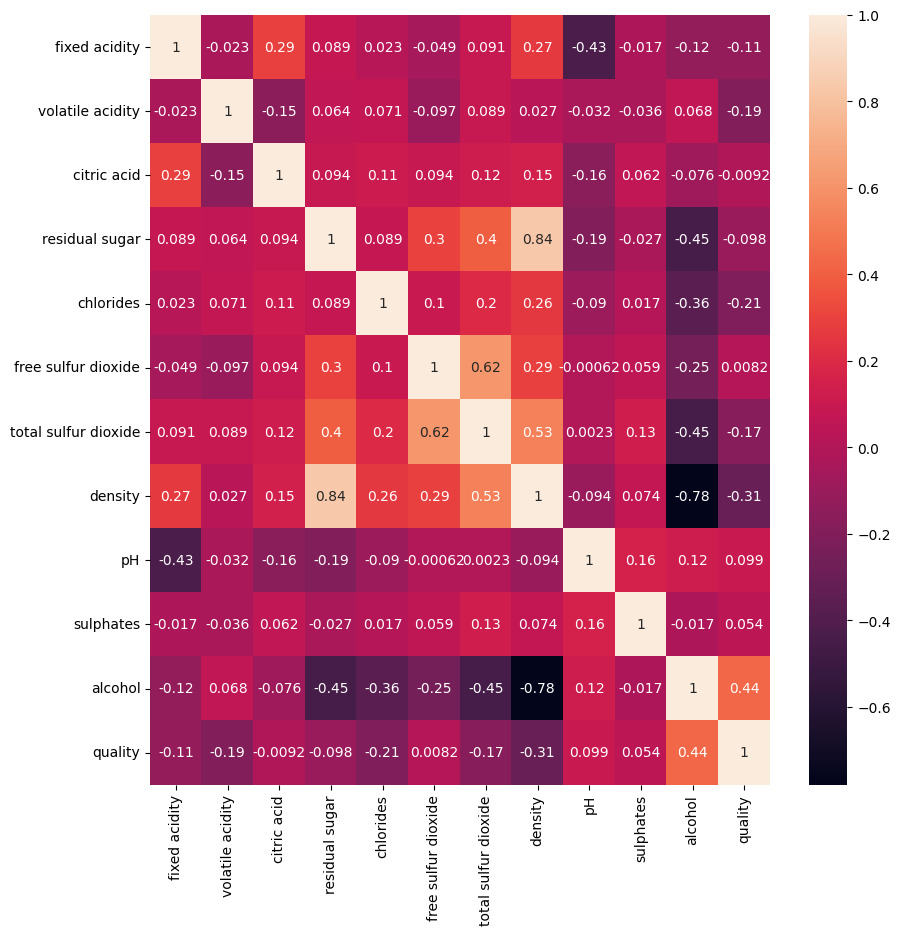

In [25]:
sns.pairplot(dane0, kind="scatter", hue='quality')
plt.show()


plt.figure(figsize=(10,10),dpi = 100)
sns.heatmap(dane0.corr(),annot = dane0.corr())
plt.show()

### Standaryzacja i weryfkiacja wyniku

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count        4898.00           4898.00      4898.00         4898.00   
mean            0.00              0.00         0.00           -0.00   
std             1.00              1.00         1.00            1.00   
min            -3.62             -1.97        -2.76           -1.14   
25%            -0.66             -0.68        -0.53           -0.93   
50%            -0.06             -0.18        -0.12           -0.23   
75%             0.53              0.41         0.46            0.69   
max             8.71              8.15        10.96           11.71   

       chlorides  free sulfur dioxide  total sulfur dioxide  density      pH  \
count    4898.00              4898.00               4898.00  4898.00 4898.00   
mean        0.00                -0.00                  0.00     0.00   -0.00   
std         1.00                 1.00                  1.00     1.00    1.00   
min        -1.68                -1.96   

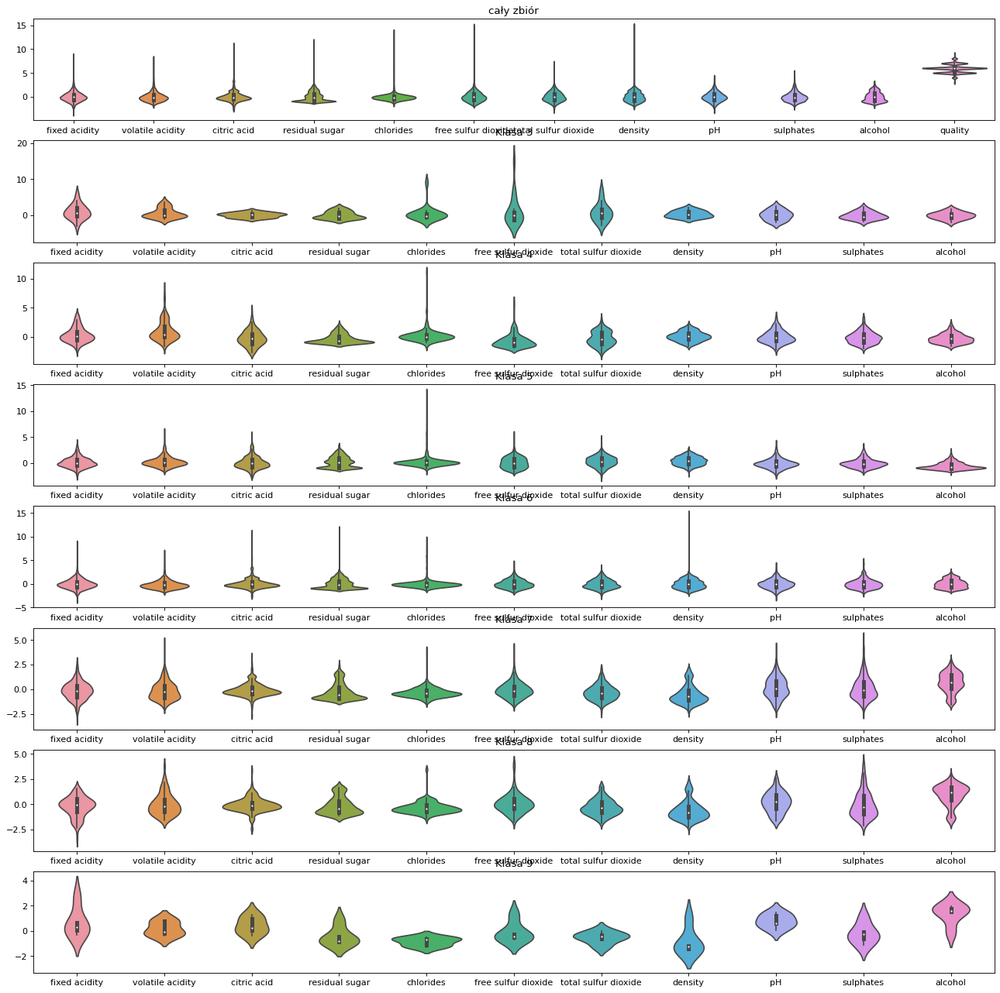

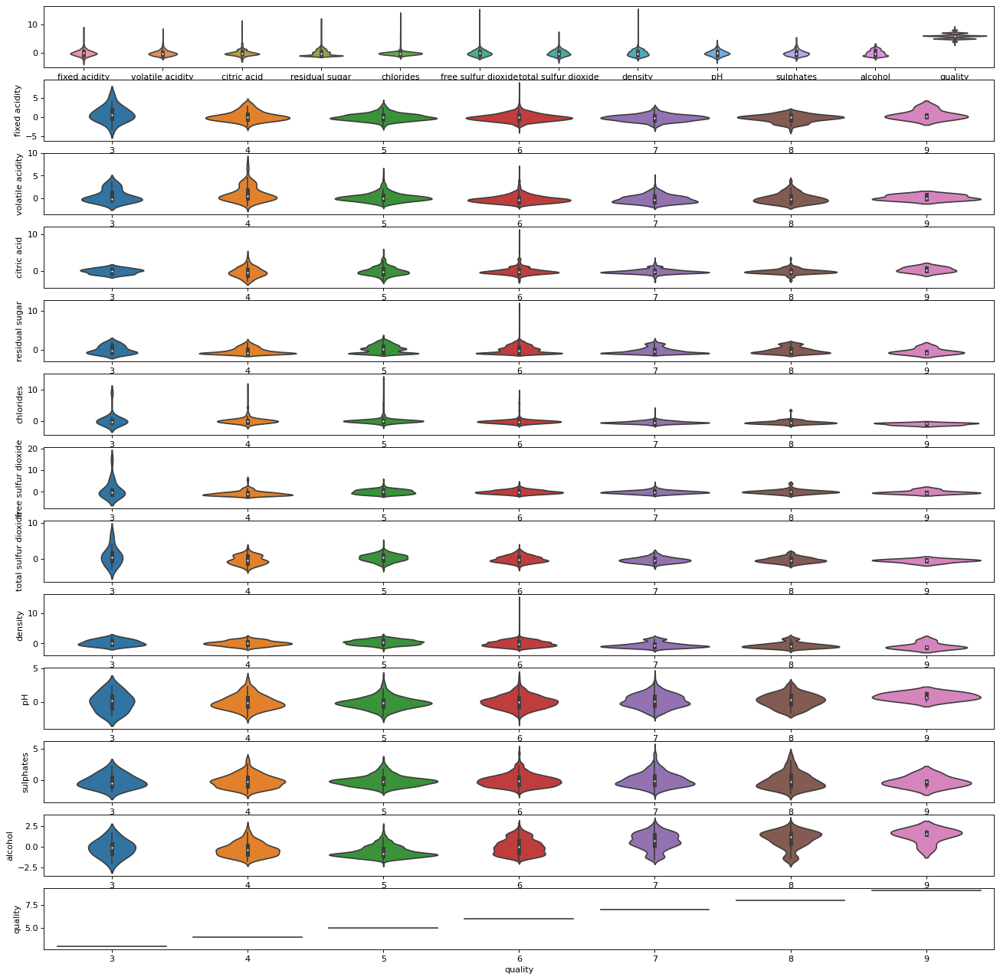

In [26]:
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()

#standaryzacja
X = dane0.drop(columns='quality')
dane_v1 = pd.DataFrame(scale.fit_transform(X), columns=X.columns)
dane_v1['quality']=dane0.quality

# dane_v1 = pd.DataFrame(preprocessing.normalize(X), columns=X.columns)
# dane_v1['quality']=dane0.quality
#-------------------------

print(dane_v1.describe())

plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(8,1,1)
sns.violinplot(data=dane_v1)
plt.title("cały zbiór")


classes = dane_v1.quality.drop_duplicates().sort_values()
for j,i in enumerate(classes):
    plt.subplot(8,1,j+2)
    plt.title("Klasa "+str(i))
    sns.violinplot(data=dane_v1.loc[dane_v1.quality==i].drop(columns='quality'))


plt.figure(figsize=(20,20), dpi= 80)
plt.subplot(13,1,1)
sns.violinplot(data=dane_v1)
j = 2
for i in dane_v1.columns:
    plt.subplot(13,1,j)
    sns.violinplot(x="quality", y = i, data=dane_v1)
    j+=1

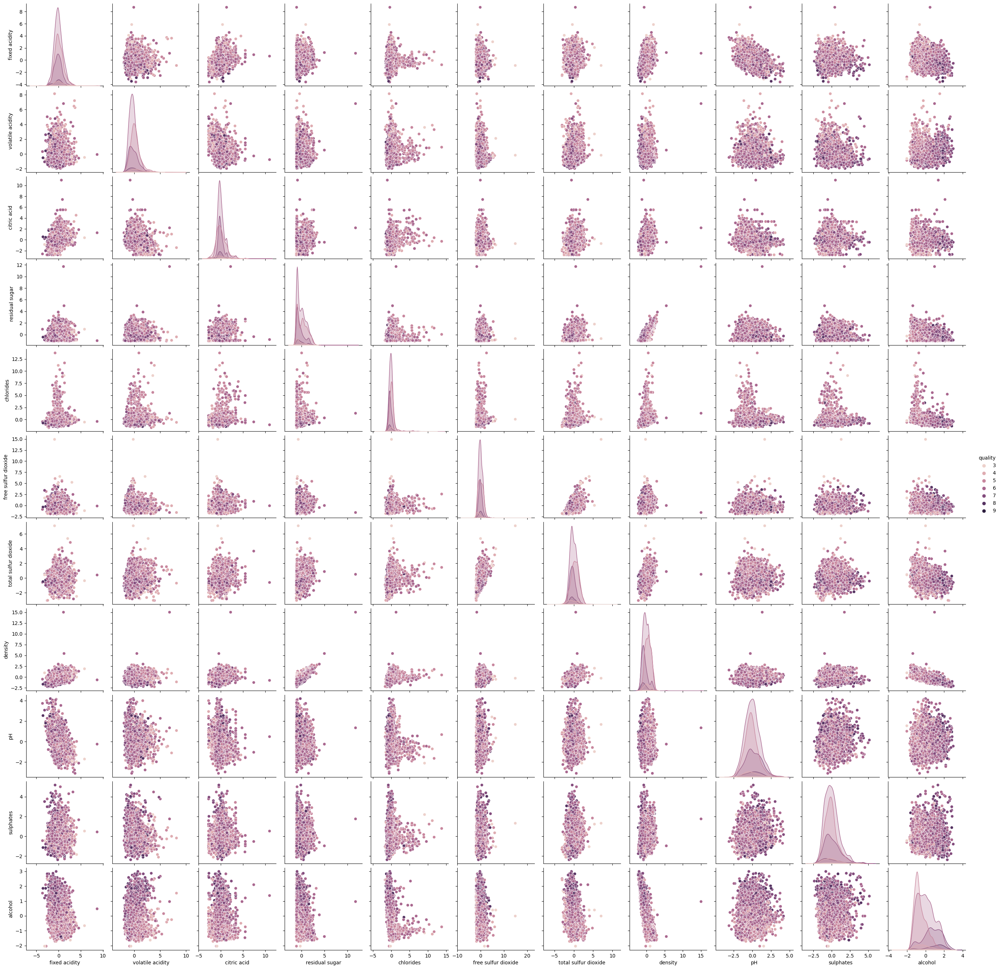

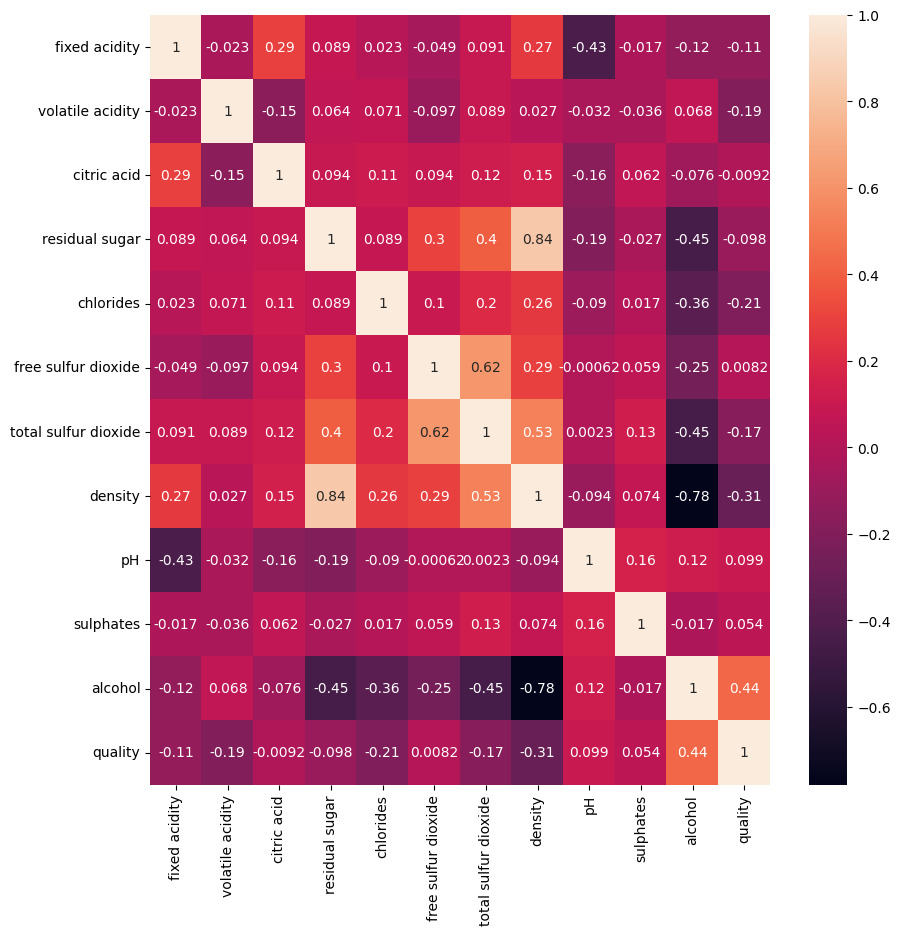

In [27]:
sns.pairplot(dane_v1, kind="scatter", hue='quality')
plt.show()

plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(dane_v1.corr(), annot=dane_v1.corr())
plt.show()

### Usuwanie atrybutów i obiektów nadmiarowych

1
1


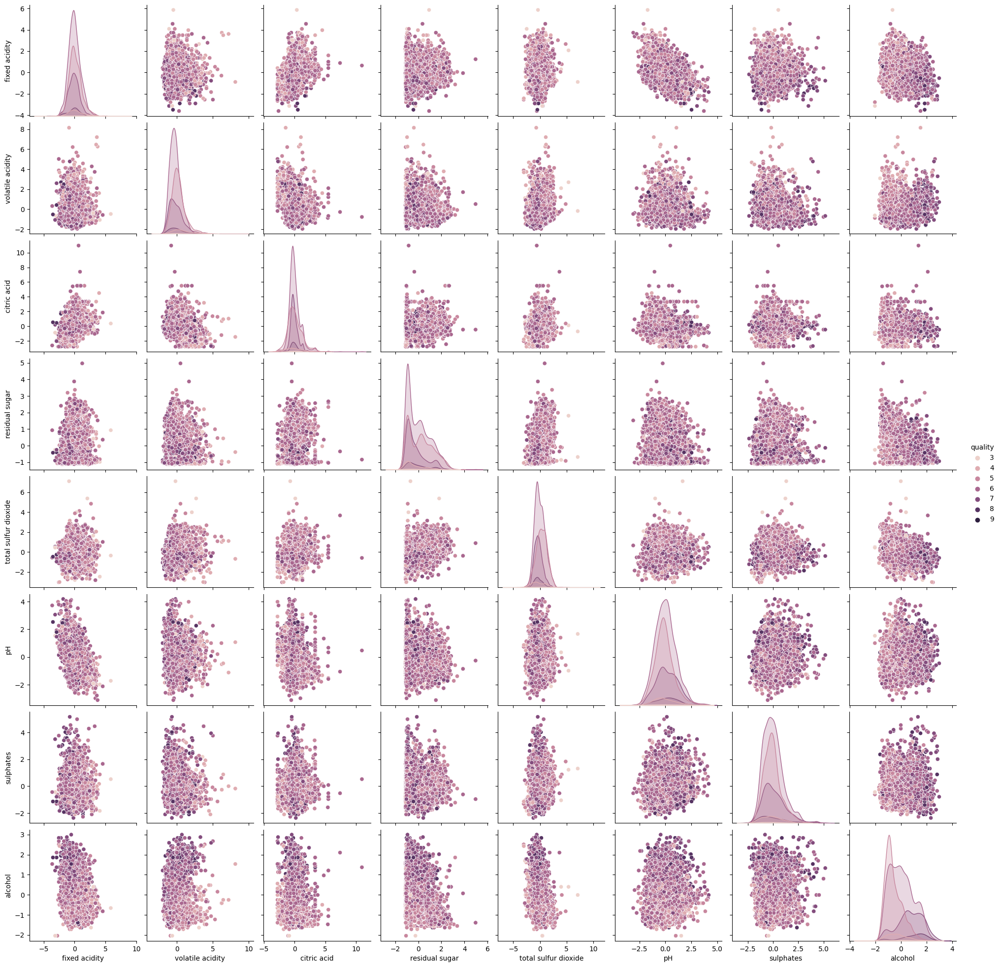

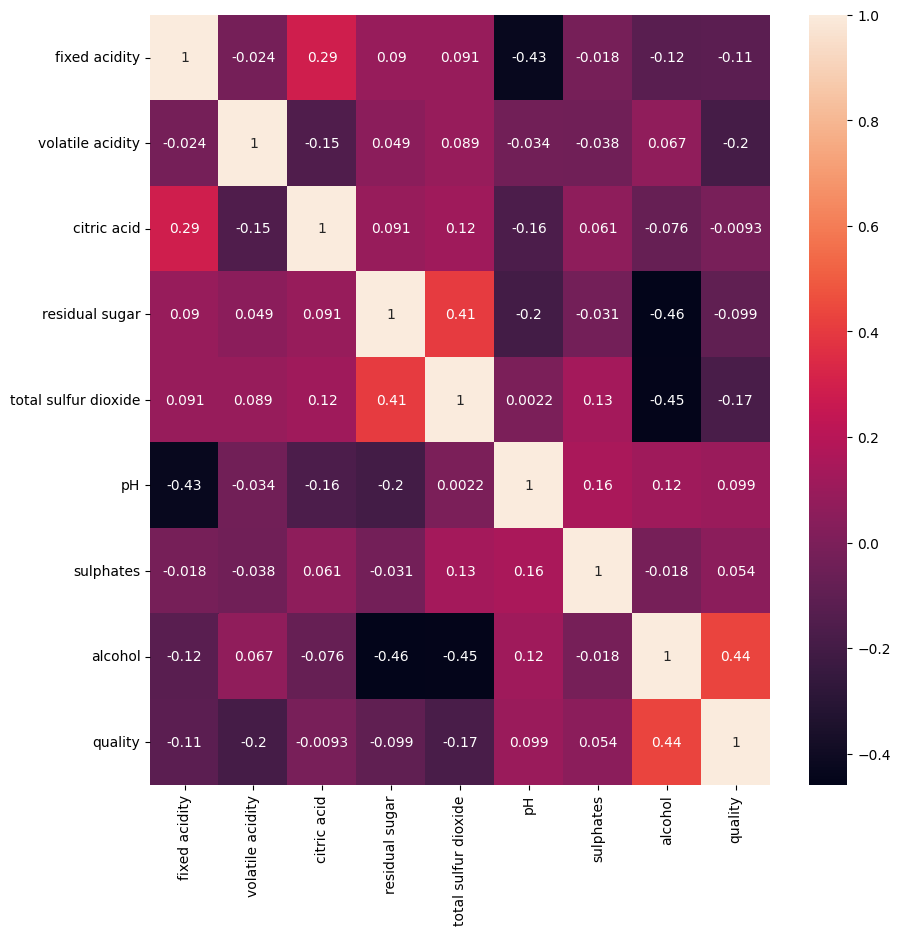

In [28]:
dane_v0_b = dane0
dane_v1_b = dane_v1
print(len(dane_v1_b.loc[dane_v1_b["fixed acidity"]>7]))
print(len(dane_v1_b.loc[dane_v1_b["residual sugar"]>10]))
dane_v2_b = dane_v1_b.drop(columns=['density','chlorides', 'free sulfur dioxide'])
dane_v2_b = dane_v2_b.loc[(dane_v1_b["fixed acidity"]<7) & (dane_v1_b["residual sugar"]<10)]
dane_v2_b = dane_v2_b.dropna()
j += 1
sns.pairplot(dane_v2_b, kind="scatter", hue='quality')
plt.show()

plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(dane_v2_b.corr(), annot=dane_v2_b.corr())
plt.show()

## Wina białe - podsumownaie analalizy eksploracyjnej
1. Podstawowe informacje o zbiorze:
    Zbiór zawiera chemiczne właściwości 4898 białych win (atrybuty liczbowe opisowe) i przyporządkowaną do nich jakość wina (atrybut liczbowy decyzyjny)

        obiektów: 4898
        liczba klas:  7
        liczba obiektow w klasach:
        quality
        3      20
        4     163
        5    1457
        6    2198
        7     880
        8     175
        9       5
        dtype: int64
        liczba atrybutów:  12
        liczba wierszy z danymi brakujacymi:  0
        liczba danych brakujacych:  0
2. Wnisoki:
* Arybuty "chlorides" oraz "free surful dioxide" wydają się mieć znikomą wartośc, stąd zostały potraktowane jako atrybuty zbędne.
* Atrybut "density" jest silnie skorelowany z "reisudal sugar" stąd został potraktowany jako zbędny.
* Na wielu wykresach punktowych pojawiają się pojedyncze punkty o wartościach znacznie oddalonych i nie będących w klasach skrajnych, stąd wina o wartościach "fixed acidity" > 7 oraz "residual sugar" > 10 zostały potraktowane jako obiekty nadmiarowe.
* Procent alkholu wydaję się być silnym indykatorem jakości alkoholu, jednak są to delikatne róznice i rozkłady wartości zahaczają o inne klasy, jest to jednak sugestia do stosowania alkoholu z wyższą wagą podczas procesów klasyfikacji.
* Wina białe przyjmują tylko wartości jakości od 3 do 9
* Analizując rozkład atrybutów doszliśmy do wniosku, że zachodzi potrzeba zmiany rozkładu atrybutów ze względu na znaczącą róznicę w zmienności i wartościach min,max atrybutu "total sulfur dioxide" oraz "free sulfur dioxide" w stosunku do pozostałych atrybutów. Wybór padał na standaryzację ze względu na stosunkową dużą ilość wartości skrajnych odpowiadającym winą o wyższej lub niższej jakości jak i wartością przypadkowym.
* Różnice pomiędzy poszczególnywmi jakościami wina są bardzo subtelne.
* Najwięcej win przyjmuje jakość w zakresie 5-7, potencjalne klalsyfikatory mogły by dobrze rozpoznawać te jakośc, co do pozostałych liczebność zbiory i charakter danych w postaci subtelnych różnic pomiędzy klasami, może być przeszkodą w poprawnej klasyfikacji.

3. Wyniki
* dane_v0_b - zbiór przed standaryzacją
* dane_v1_b - zbiór po standaryzacji
* dane_v2_b - zbiór ustandaryzowany bez zbędnych atrybutów i obiektów


# Klasyfikacja - drzewa decyzyjne

Testowanie różniej głebokości drzew dla wina czerwonego

/tmp/ipykernel_5597/1753391867.py:31: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax= plt.subplot()


[Text(0, 0.5, '3'),
 Text(0, 1.5, '4'),
 Text(0, 2.5, '5'),
 Text(0, 3.5, '6'),
 Text(0, 4.5, '7'),
 Text(0, 5.5, '8')]

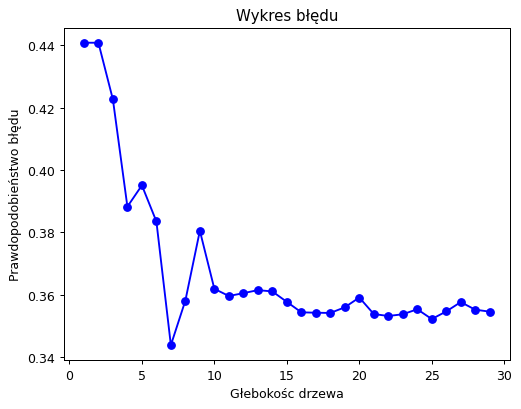

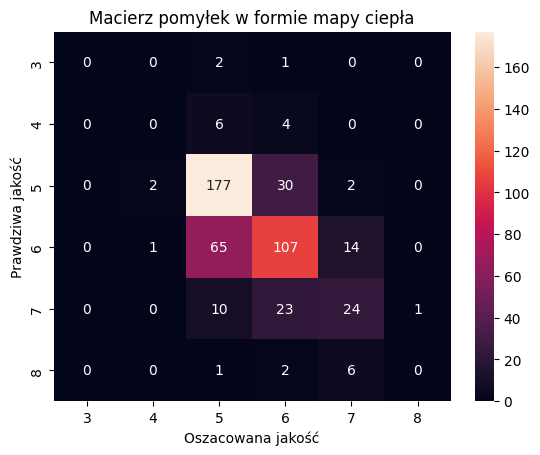

macierz pomyłek - zbiór uczący, dokładność: 0.768609865470852
0.768609865470852
[[  4   0   1   2   0   0]
 [  0  14  23   5   1   0]
 [  0   1 425  38   4   0]
 [  0   2 118 311  17   1]
 [  0   0  11  28 100   0]
 [  0   0   2   3   1   3]]
macierz pomyłek - zbiór testowy, dokładność: 0.6443514644351465
0.6443514644351465
[[  0   0   2   1   0   0]
 [  0   0   6   4   0   0]
 [  0   2 177  30   2   0]
 [  0   1  65 107  14   0]
 [  0   0  10  23  24   1]
 [  0   0   1   2   6   0]]


In [100]:

dane = podziel(dane_v1_cz,0.3)

kvals = range(1, 30)
rss_all = np.zeros(29)
for k in kvals:
    run = experiment.start_logging()
    run.log("Depth", k)
    score = 0
    for i in range(1,30):
        model = tree.DecisionTreeClassifier(max_depth=k)
        model.fit(dane['opis_ucz'],dane['dec_ucz'])
        predictions = model.predict(dane['opis_test'])
        score += 1-model.score(dane['opis_test'],dane['dec_test'])
    rss_all[k-1] = score/30
    run.log("Error", score/30)
    model_name = "model_decision_tree_" + str(k)
    run.complete()
plt.figure(dpi=90)
plt.plot(kvals, rss_all,'bo-')
plt.title('Wykres błędu')
plt.xlabel('Głebokośc drzewa')
plt.ylabel('Prawdopodobieństwo błędu')

granice(tree.DecisionTreeClassifier(max_depth=7), dane, 0,1, "drzewo o głębokości " + str(7) + " dla zbioru win czerwonych")


model = tree.DecisionTreeClassifier(max_depth=7)
pred=[3,4,5,6,7,8]
#weryfikacja
mp=weryfikuj(tree.DecisionTreeClassifier(max_depth=7), dane, [0,1,2,3,4,5,6,7,8,9,10])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość')
ax.set_title('Macierz pomyłek w formie mapy ciepła')
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred)

Testowanie różniej głebokości drzew dla wina białego

macierz pomyłek - zbiór uczący, dokładność: 0.9288007003209805
0.9288007003209805
[[  12    0    1    2    0    0    0]
 [   0  105    4    9    1    0    0]
 [   0    1  952   51    2    1    0]
 [   0    0   27 1508   26    2    0]
 [   0    0    3   75  509    2    0]
 [   0    0    2   20   13   94    0]
 [   0    0    0    1    1    0    3]]
macierz pomyłek - zbiór testowy, dokładność: 0.5711368277739959
0.5711368277739959
[[  0   1   1   3   0   0   0]
 [  0  10  19  10   4   1   0]
 [  4  21 262 134  27   2   0]
 [  1   7 128 402  83  11   1]
 [  0   0  17 111 148  14   1]
 [  0   0   0  14  14  17   1]
 [  0   0   0   0   0   0   0]]


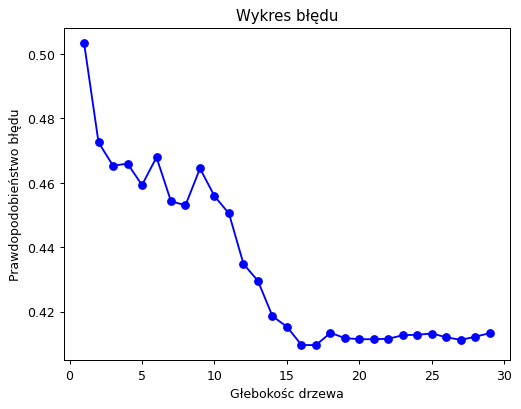

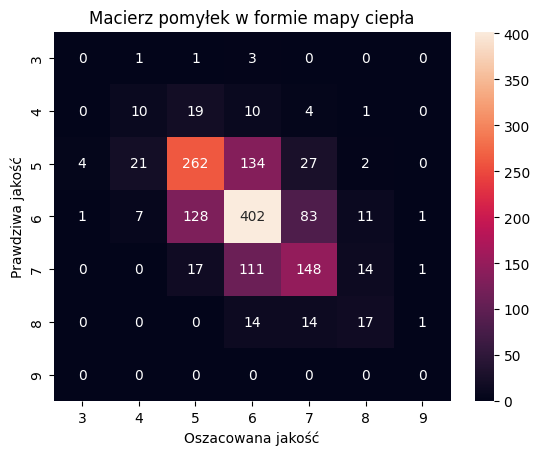

In [74]:
daneb = podziel(dane_v2_b,0.3)

kvals = range(1, 30)
rss_all = np.zeros(29)
for k in kvals:
    score = 0
    for i in range(1,30):
        model = tree.DecisionTreeClassifier(max_depth=k)
        model.fit(daneb['opis_ucz'],daneb['dec_ucz'])
        predictions = model.predict(daneb['opis_test'])
        score += 1-model.score(daneb['opis_test'],daneb['dec_test'])
    rss_all[k-1] = score/30
plt.figure(dpi=90)
plt.plot(kvals, rss_all,'bo-')
plt.title('Wykres błędu')
plt.xlabel('Głebokośc drzewa')
plt.ylabel('Prawdopodobieństwo błędu')

granice(tree.DecisionTreeClassifier(max_depth=15), daneb, 0,1, "drzewo o głębokości " + str(7) + " dla zbioru win czerwonych")

model = tree.DecisionTreeClassifier(max_depth=15)

pred=[3,4,5,6,7,8,9]
#weryfikacja
mp=weryfikuj(model,daneb,[0,1,2,3,4,5,6,7])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość');
ax.set_title('Macierz pomyłek w formie mapy ciepła');
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred);


### Wnioski
* Drzewo decyzyjne nie osiąga najlepszych efektów ani przy zbiorze białym ani czerwonym, dokładanośc dochodzi do 60%
* Macierze pomyłek pokazują stosunkowo dobre predykcje dla wartości środkowych jednak dla jakości nie z przedziału 5-7 predykcje zaczynają mieć charakter losowy.
* Drzewo decyzjne nie sprawdza się w klasyfikacji jakości win z danych zbiorów, ze względu na charakter danych i braku jasnego rozróznienia klas poprzez wartości atrybutów.

# Klasyfikacja k-sąsiadów

Dobór optymalnej liczby sąsiadów dla klasyfikatora - wina czerwone

Liczba obiektów zbioru uczącego:  1115
Liczba obiektów zbioru testowego:  478


Text(0, 0.5, 'Prawdopodobieństwo błędu')

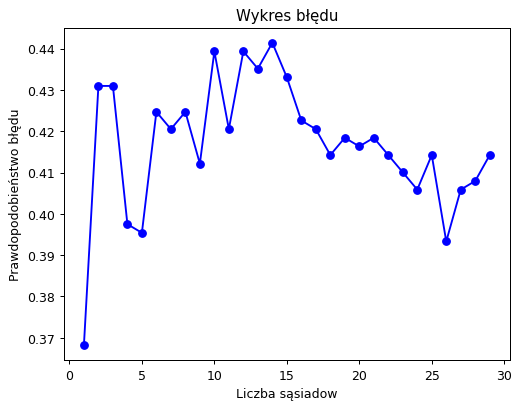

In [75]:

from azureml.core import Workspace, Dataset

dane = podziel(dane_v1_cz,0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane["opis_test"]))

kvals = range(1, 30)
rss_all = np.zeros(29)
for k in kvals:
    model = KNeighborsClassifier(n_neighbors=k)
    model.fit(dane['opis_ucz'],dane['dec_ucz'])
    predictions = model.predict(dane['opis_test'])
    rss_all[k-1] = 1-model.score(dane['opis_test'],dane['dec_test'])
plt.figure(dpi=90)
plt.plot(kvals, rss_all,'bo-')
plt.title('Wykres błędu')
plt.xlabel('Liczba sąsiadow')
plt.ylabel('Prawdopodobieństwo błędu')


Klasyfikacja, wyświetlenie macierzy pomyłek i mapy ciepła

macierz pomyłek - zbiór uczący, dokładność: 1.0
1.0
[[  7   0   0   0   0   0]
 [  0  43   0   0   0   0]
 [  0   0 468   0   0   0]
 [  0   0   0 449   0   0]
 [  0   0   0   0 139   0]
 [  0   0   0   0   0   9]]
macierz pomyłek - zbiór testowy, dokładność: 0.6317991631799164
0.6317991631799164
[[  0   2   0   1   0   0]
 [  1   1   6   2   0   0]
 [  1   4 155  44   6   1]
 [  0   7  48 112  20   0]
 [  0   1   6  17  33   1]
 [  0   0   0   1   7   1]]


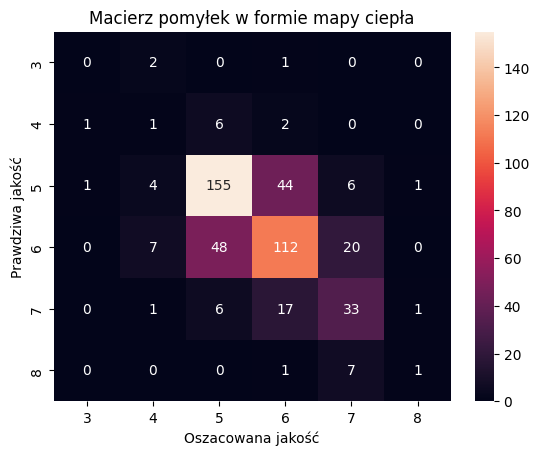

In [76]:

model = KNeighborsClassifier(n_neighbors=1)
# wybór atrybutów
pred=[3,4,5,6,7,8]

#weryfikacja
mp=weryfikuj(model,dane,[0,1,2,3,4,5,6,7,8,9,10])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred);


Dobór optymalnej liczby sąsiadów dla klasyfikatora - wina białe

Liczba obiektów zbioru uczącego:  3427
Liczba obiektów zbioru testowego:  1469


Text(0, 0.5, 'Prawdopodobieństwo błędu')

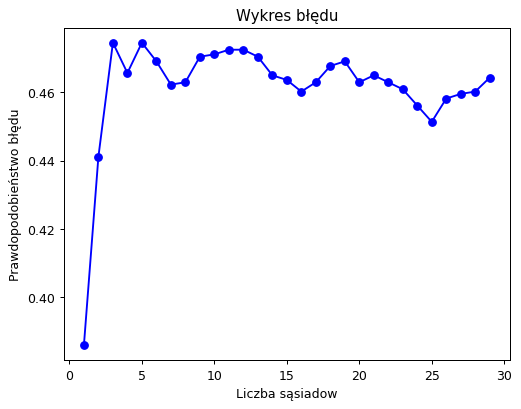

In [65]:

from azureml.core import Workspace, Dataset

dane = podziel(dane_v2_b,0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane["opis_test"]))


kvals = range(1, 30)
rss_all = np.zeros(29)
for k in kvals:
    model = KNeighborsClassifier(n_neighbors=k)
    model.fit(dane['opis_ucz'],dane['dec_ucz'])
    predictions = model.predict(dane['opis_test'])
    rss_all[k-1] = 1-model.score(dane['opis_test'],dane['dec_test'])
plt.figure(dpi=90)
plt.plot(kvals, rss_all,'bo-')
plt.title('Wykres błędu')
plt.xlabel('Liczba sąsiadow')
plt.ylabel('Prawdopodobieństwo błędu')


Klasyfikacja, wyświetlenie macierzy pomyłek i mapy ciepła

macierz pomyłek - zbiór uczący, dokładność: 1.0
1.0
[[  15    0    0    0    0    0    0]
 [   0  119    0    0    0    0    0]
 [   0    0 1007    0    0    0    0]
 [   0    0    0 1563    0    0    0]
 [   0    0    0    0  589    0    0]
 [   0    0    0    0    0  129    0]
 [   0    0    0    0    0    0    5]]
macierz pomyłek - zbiór testowy, dokładność: 0.6140231449965963
0.6140231449965963
[[  0   2   1   2   0   0   0]
 [  0  11  19  12   1   1   0]
 [  3  11 274 140  17   4   1]
 [  2  14 104 430  73  10   0]
 [  0   2  22  86 160  19   2]
 [  0   1   0   9   9  27   0]
 [  0   0   0   0   0   0   0]]


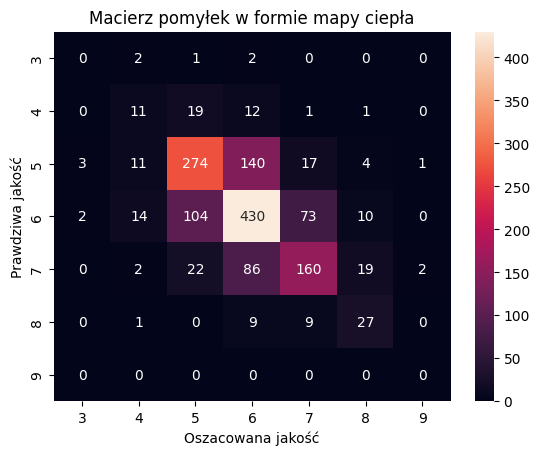

In [66]:

model = KNeighborsClassifier(n_neighbors=1)
# wybór atrybutów
pred=[3,4,5,6,7,8,9]

#weryfikacja
mp=weryfikuj(model,dane,[0,1,2,3,4,5,6,7])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred);


### Wnioski
- Dokładność dla metody k-sąsiadów oscyluje w okolicach 60% dla obu zbiorów
- Optymalną ilością sąsiadów okazuje się 1 - wynika to z faktu że obiekty mają bardzo małą rozbieżność wartości - wyznaczając tylko jednego sąsiada mamy największą szansę na to że przydzielimy obiekt do odpowiedniej klasy
- Użycie większej liczby sąsiadów znacznie zmniejsza dokładność klasyfikacji

# Naiwny klasyfikator Bayesa

Zastosowanie modelu klasyfikatora dla zbioru win czerwonych

Poniżej wyświetlono wizualizację granic decyzyjnych oraz macierze pomyłek, które posłużą do weryfikacji skuteczności klasyfikatora Bayesa

Liczba obiektów zbioru uczącego:  1115
Liczba obiektów zbioru testowego:  478


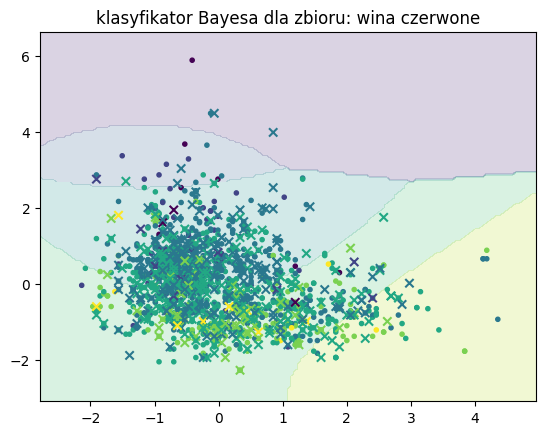

macierz pomyłek - zbiór uczący, dokładność: 0.5452914798206278
0.5452914798206278
[[  3   0   3   1   0   0]
 [  3   7  23  10   0   0]
 [  8  21 328  94  16   1]
 [  3  13 145 188  95   5]
 [  0   1   6  49  80   3]
 [  0   0   0   1   6   2]]
macierz pomyłek - zbiór testowy, dokładność: 0.5753138075313807
0.5753138075313807
[[  0   1   2   0   0   0]
 [  0   0   6   4   0   0]
 [  6   5 150  38  12   0]
 [  1   6  62  92  24   2]
 [  0   0   5  20  32   1]
 [  0   0   0   2   6   1]]


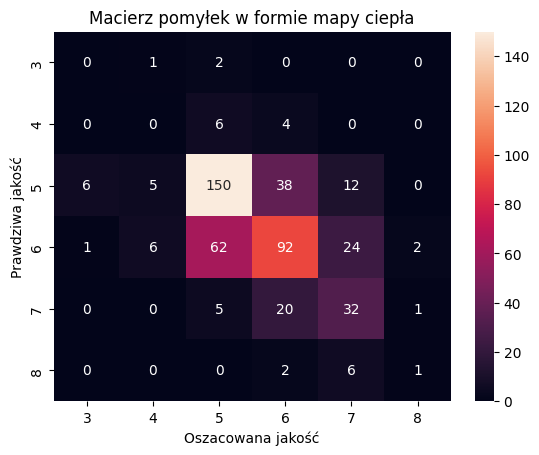

In [91]:
from azureml.core import Workspace, Dataset

dane = podziel(dane_v1_cz,0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane["opis_test"]))

pred = [3,4,5,6,7,8]

model = GaussianNB()
granice(model,dane,0,1,"klasyfikator Bayesa dla zbioru: wina czerwone")
plt.show()
mp = weryfikuj(model,dane,[0,1,2,3,4,5,6,7,8,9,10])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred)
plt.show()

Zastosowanie naiwnego klasyfikatora Bayesa dla zbioru danych zawężonych do średnich jakości (quality = {5,6,7})

Liczba obiektów zbioru uczącego:  1058
Liczba obiektów zbioru testowego:  454


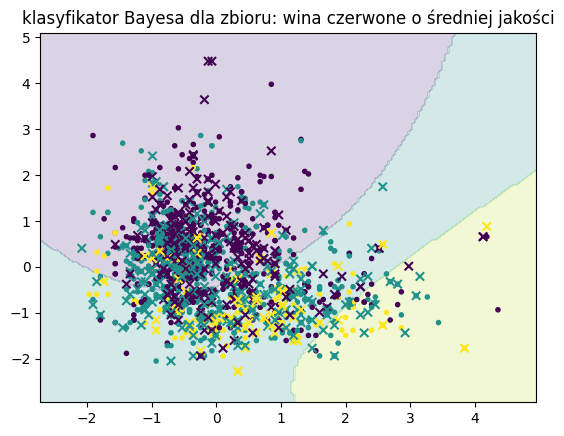

macierz pomyłek - zbiór uczący, dokładność: 0.5897920604914934
0.5897920604914934
[[364 101  22]
 [156 174 105]
 [  6  44  86]]
macierz pomyłek - zbiór testowy, dokładność: 0.6013215859030837
0.6013215859030837
[[144  34  14]
 [ 58  87  56]
 [  5  14  42]]


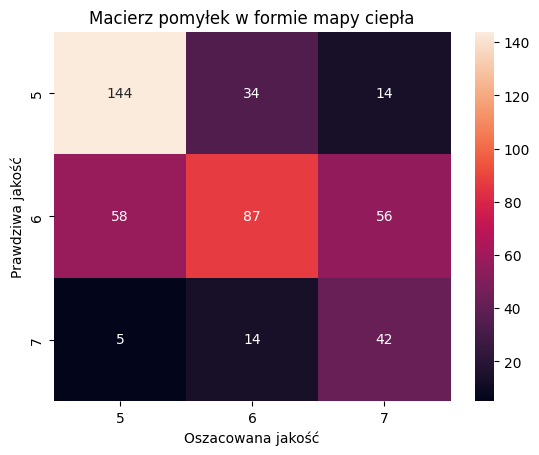

In [90]:
from azureml.core import Workspace, Dataset

dane = dane_v1_cz.copy()
dane.drop(dane[(dane['quality'] < 5) | (dane['quality'] > 7)].index, inplace=True)

dane2 = podziel(dane, 0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane2["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane2["opis_test"]))

pred = [5,6,7]

model = GaussianNB()

granice(model,dane2,0,1,"klasyfikator Bayesa dla zbioru: wina czerwone o średniej jakości")
plt.show()
mp = weryfikuj(model,dane2,[0,1,2,3,4,5,6,7,8,9,10])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred)
plt.show()

Zastosowanie modelu klasyfikatora dla zbioru win białych

Poniżej wyświetlono wizualizację granic decyzyjnych oraz macierze pomyłek, które posłużą do weryfikacji skuteczności klasyfikatora Bayesa

Liczba obiektów zbioru uczącego:  3427
Liczba obiektów zbioru testowego:  1469


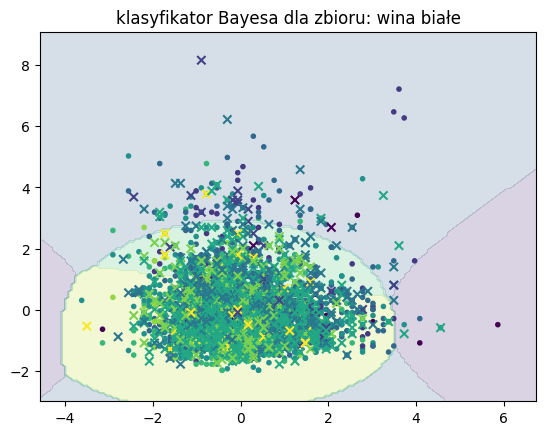

macierz pomyłek - zbiór uczący, dokładność: 0.5016049022468632
0.5016049022468632
[[  3   2   2   8   0   0   0]
 [  0  25  38  53   3   0   0]
 [  1  41 555 375  35   0   0]
 [  2  22 392 898 244   5   0]
 [  0   3  68 277 235   6   0]
 [  0   3  12  54  57   3   0]
 [  0   0   0   1   4   0   0]]
macierz pomyłek - zbiór testowy, dokładność: 0.5071477195371
0.5071477195371
[[  2   1   0   2   0   0]
 [  0  12  14  16   2   0]
 [  1  14 242 184   8   1]
 [  1  14 162 357  97   2]
 [  0   0  27 129 131   4]
 [  0   1   2  16  26   1]]


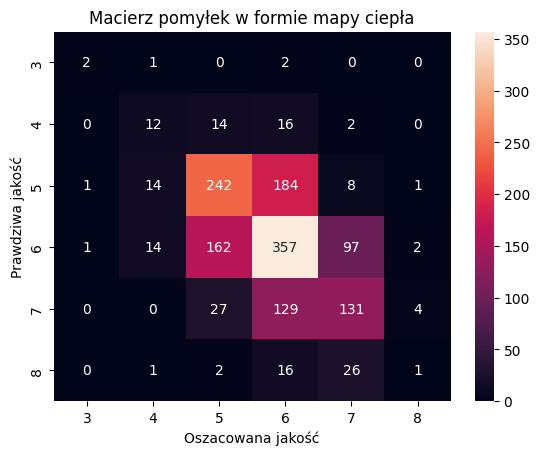

In [76]:
from azureml.core import Workspace, Dataset

dane = podziel(dane_v2_b,0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane["opis_test"]))

pred = [3,4,5,6,7,8,9]

model = GaussianNB()
granice(model,dane,0,1,"klasyfikator Bayesa dla zbioru: wina białe")
plt.show()
mp = weryfikuj(model,dane,[0,1,2,3,4,5,6,7])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred)
plt.show()

Zastosowanie naiwnego klasyfikatora Bayesa dla zbioru danych zawężonych do średnich jakości (quality = {5,6,7})

Liczba obiektów zbioru uczącego:  3173
Liczba obiektów zbioru testowego:  1360


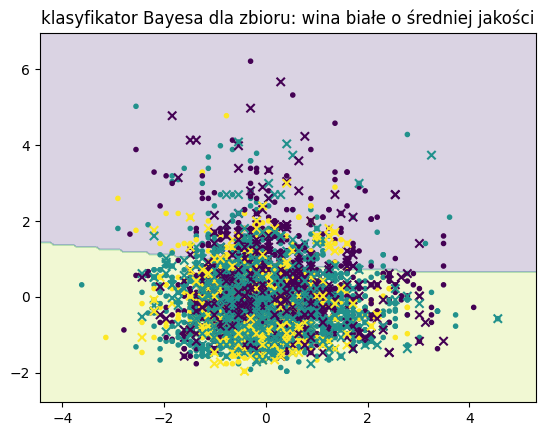

macierz pomyłek - zbiór uczący, dokładność: 0.5436495430192247
0.5436495430192247
[[604 359  40]
 [418 838 294]
 [ 69 268 283]]
macierz pomyłek - zbiór testowy, dokładność: 0.5455882352941176
0.5455882352941176
[[266 172  16]
 [176 344 126]
 [ 26 102 132]]


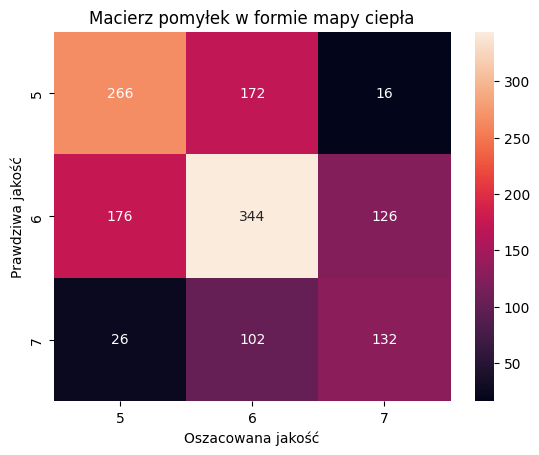

In [92]:
from azureml.core import Workspace, Dataset

dane = dane_v2_b.copy()
dane.drop(dane[(dane['quality'] < 5) | (dane['quality'] > 7)].index, inplace=True)

dane2 = podziel(dane, 0.3)
print('Liczba obiektów zbioru uczącego: ', len(dane2["opis_ucz"]))
print('Liczba obiektów zbioru testowego: ', len(dane2["opis_test"]))

pred = [5,6,7]

model = GaussianNB()

granice(model,dane2,0,1,"klasyfikator Bayesa dla zbioru: wina białe o średniej jakości")
plt.show()
mp = weryfikuj(model,dane2,[0,1,2,3,4,5,6,7])
ax= plt.subplot()
sns.heatmap(mp,annot = mp,fmt='g')
ax.set_xlabel('Oszacowana jakość');ax.set_ylabel('Prawdziwa jakość'); 
ax.set_title('Macierz pomyłek w formie mapy ciepła'); 
ax.xaxis.set_ticklabels(pred); ax.yaxis.set_ticklabels(pred)
plt.show()

### Wnioski

- Dokładność klasyfikatora Bayesa mieści się w zakresie 50%-60%, zarówno dla wina czerwonego jak i białego. Oznacza to że klasyfikator nie osiąga zbyt dobrych efektów.

- Przy wykorzystaniu zbioru testowego zawężonego wyłącznie do win o jakości z przedziału {5,6,7} dokładność klasyfikacji wzrosła jedynie o kilka procent co pokazuje że wina należące do tej grupy mogą stanowić problem przy klasyfikacji ze względu na zbliżone wartości atrybtów.

- Macierze pomyłek nie przedstawiają optymistycznych rezultatów ani dla zbioru uczącego ani dla zbioru testowego. Niska dokładność uzyskana w zbiorze uczącym wskazuje na brak przydatności modelu naiwnego klasyfikatora Bayesa.

- Ze względu na dużą ilość danych o przybliżonych atrybutach wizualizacja granic decyzyjnych nie pozwala na określenie przydatności klasyfikatora Bayesa. Wyraźnie widać to na wizualizacji granic dla wina czerwonego średniej jakości, gdzie mimo określonego wyznaczenia granic obiekty z poszczególnych klas nie są rozdzielone grupami zgodnie z wyznaczonymi obszarami a tworzą jedno duże skupisko.


# Podsumowanie

Dane dotyczące jakości wina vinho verde okazały się trudnym przedmiotem klasyfikacji ze względu na niewiele wartości skrajnych dla win bardzo kiepskich i bardzo dobrych oraz ze względu na subtelne różnice w warościach atrybutów poszczególnych klas. Po wykonaniu eksploracji i zbadaniu skuteczności kilku modeli klasyfikacji, wszystkie wykorzystane modele osiągnęły zbliżoną dokładność na poziomie 60%. Mimo braku znaczących różnic w dokładności najlepszym wyborem wydaje się klasyfikator k-sąsiadów a konkretnie klasyfikator najbliższego sąsiada. Wykorzystane modele nie nadają się do realnego użycia, należałoby użyć modeli lepiej radzących sobie z danymi o małym odchyleniu.